# (25) Dataloder -- & Dataset

**Motivation**: Create dataloaders, next I will be ready to fit. <br>

In [1]:
# HIDE CODE


import os, sys
from copy import deepcopy as dc
from os.path import join as pjoin
from IPython.display import display, IFrame, HTML

# tmp & extras dir
git_dir = pjoin(os.environ['HOME'], 'Dropbox/git')
extras_dir = pjoin(git_dir, 'jb-MTMST/_extras')
fig_base_dir = pjoin(git_dir, 'jb-MTMST/figs')
tmp_dir = pjoin(git_dir, 'jb-MTMST/tmp')

# GitHub
sys.path.insert(0, pjoin(git_dir, '_MTMST'))
from figures.fighelper import *
from model.opticflow import *

# warnings, tqdm, & style
warnings.filterwarnings('ignore', category=DeprecationWarning)
from tqdm.notebook import tqdm
from rich.jupyter import print
%matplotlib inline
set_style()

## Trainer

In [2]:
from model.vae2d import VAE
from model.train import TrainerVAE

from torch import _dynamo
_dynamo.config.cache_size_limit = 1024

In [3]:
vae = VAE(ConfigVAE(
    n_kers=4,
    n_latent_scales=3, n_groups_per_scale=20, n_latent_per_group=3,
    n_pre_blocks=0, n_post_cells=3, n_cells_per_cond=2,
    scale_init=False, spectral_norm=0,
    ada_groups=True,
))
tr = TrainerVAE(
    # model=torch.compile(vae),
    model=vae,
    cfg=ConfigTrain(
        lr=0.001, batch_size=512, epochs=1000, grad_clip=1000,
        lambda_anneal=True, lambda_norm=1e-2, optimizer_kws={'eps': 1e-3},
        kl_beta=0.25, kl_anneal_cycles=1),
    device='cuda:0',
)
vae.cfg.total_latents()

105

In [4]:
vae.print()
vae.scales

+-------------+------------+
| Module Name | Num Params |
+-------------+------------+
|     VAE     |  10.9 Mil  |
|     ---     |    ---     |
|     stem    |   1.1 K    |
|     pre     |     0      |
|  enc_tower  |  5.6 Mil   |
| enc_sampler |  1.3 Mil   |
| dec_sampler |  1.3 Mil   |
|    expand   |   52.7 K   |
|  dec_tower  |  2.6 Mil   |
|     post    |   10.3 K   |
|     out     |    290     |
|  cos_recon  |     0      |
|   l2_recon  |     0      |
|   l1_recon  |     0      |
|  l1_weight  |     0      |
+-------------+------------+

[16, 8, 4]

In [5]:
vae.latent_scales()[1]

{'idx-0_scale-4_group-0': range(0, 3),
 'idx-1_scale-4_group-1': range(3, 6),
 'idx-2_scale-4_group-2': range(6, 9),
 'idx-3_scale-4_group-3': range(9, 12),
 'idx-4_scale-4_group-4': range(12, 15),
 'idx-5_scale-8_group-0': range(15, 18),
 'idx-6_scale-8_group-1': range(18, 21),
 'idx-7_scale-8_group-2': range(21, 24),
 'idx-8_scale-8_group-3': range(24, 27),
 'idx-9_scale-8_group-4': range(27, 30),
 'idx-10_scale-8_group-5': range(30, 33),
 'idx-11_scale-8_group-6': range(33, 36),
 'idx-12_scale-8_group-7': range(36, 39),
 'idx-13_scale-8_group-8': range(39, 42),
 'idx-14_scale-8_group-9': range(42, 45),
 'idx-15_scale-16_group-0': range(45, 48),
 'idx-16_scale-16_group-1': range(48, 51),
 'idx-17_scale-16_group-2': range(51, 54),
 'idx-18_scale-16_group-3': range(54, 57),
 'idx-19_scale-16_group-4': range(57, 60),
 'idx-20_scale-16_group-5': range(60, 63),
 'idx-21_scale-16_group-6': range(63, 66),
 'idx-22_scale-16_group-7': range(66, 69),
 'idx-23_scale-16_group-8': range(69, 72),


In [6]:
len(vae.all_conv_layers), len(vae.all_log_norm)

(229, 225)

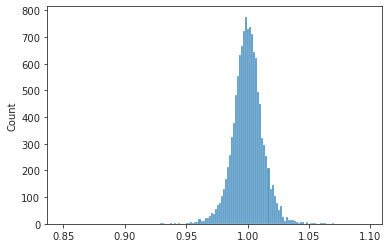

In [7]:
all_norm = torch.cat(vae.all_log_norm)
all_norm = torch.exp(all_norm)
sns.histplot(to_np(all_norm), bins=150);

In [8]:
tr.optim

Adamax (
Parameter Group 0
    betas: (0.9, 0.999)
    differentiable: False
    eps: 0.001
    foreach: None
    initial_lr: 0.001
    lr: 0.001
    maximize: False
    weight_decay: 0.0001
)

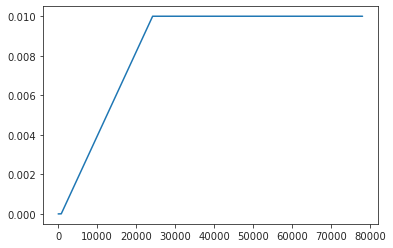

In [9]:
plt.plot(tr.wd_coeffs)

## Review train options

In [10]:
print(f"VAE:\t\t{vae.cfg.name()}\nTrainer:\t{tr.cfg.name()}")

VAE:            k-32_z-3x[5,10,20]_cells-2_post-1x3
Trainer:        ep1000-b512-lr(0.001)_beta(0.25)-anneal(1x0.3)_lambda(0.01)_grad(1000)

## Train

In [11]:
comment = f"eps1e-3_{tr.cfg.name()}"
tr.train(comment=comment)

epoch # 1000, avg loss: 13.132170: 100%|██████████| 1000/1000 [20:31:55<00:00, 73.92s/it]  


epoch # 1000, avg loss: 12.962740: 100%|██████████| 1000/1000 [20:25:02<00:00, 73.50s/it]  


In [10]:
self = tr

In [36]:
grads = np.array([
    torch.linalg.norm(p.grad).item()
    for p in self.model.parameters()
])
grads.mean()

131162.6857019161

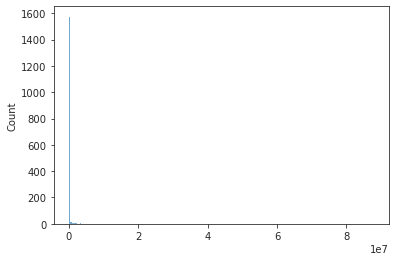

In [21]:
sns.histplot(grads, bins=200);

In [34]:
len(np.where(grads > 500)[0]) / len(grads) * 100

36.32425742574257

In [37]:
grad_norm = nn.utils.clip_grad_norm_(
    parameters=self.model.parameters(),
    max_norm=self.cfg.grad_clip,
).item()
grad_norm

96314424.0

In [38]:
grads = np.array([
    torch.linalg.norm(p.grad).item()
    for p in self.model.parameters()
])
grads.mean()

0.6809088393905381

In [ ]:
grad_norm = nn.utils.clip_grad_norm_(
    parameters=self.model.parameters(),
    max_norm=self.cfg.grad_clip,
).item()

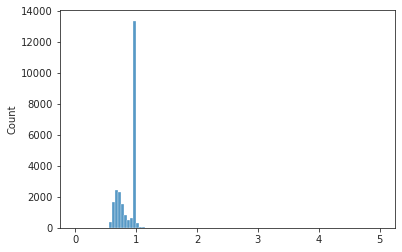

In [11]:
all_norm = [torch.exp(n.ravel()) for n in vae.all_log_norm]
all_norm = to_np(torch.cat(all_norm))
sns.histplot(all_norm, bins=np.linspace(0, 5, 101));

In [12]:
np.max(all_norm), (all_norm > 5).sum() / len(all_norm)

(1.848514, 0.0)

In [13]:
vae.cfg.name()

'k-64_z-3x[5,10,20]_cells-2_post-1x3'

In [14]:
val, loss = tr.validate(n_samples=4096)
{k: v.mean() for k, v in loss.items()}

{'kl': 40.49877,
 'l1': 0.8557237,
 'l2': 0.3179289,
 'epe': 2.7980604,
 'cos': 5.348371}

fig/sample

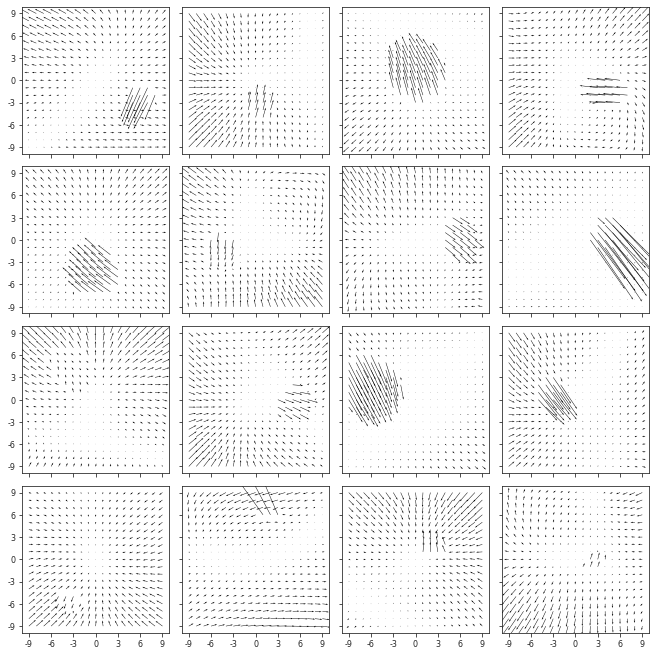

fig/corr_z

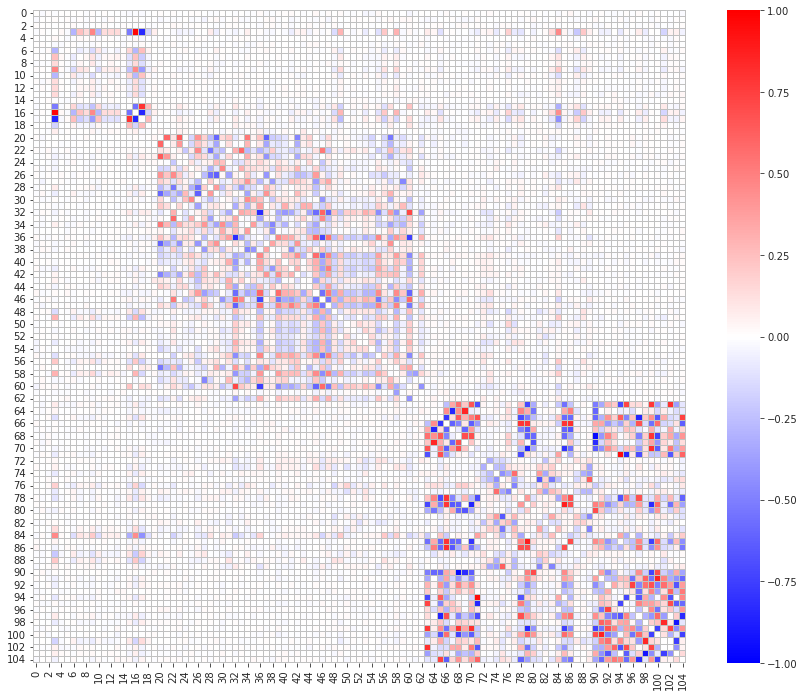

fig/regression

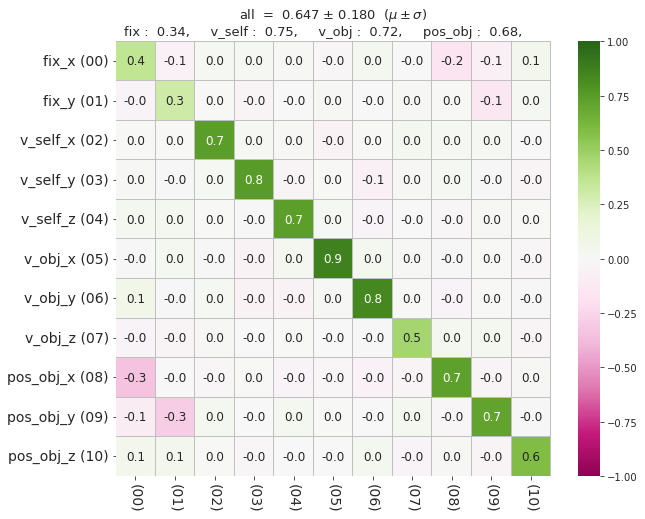

fig/mutual_info

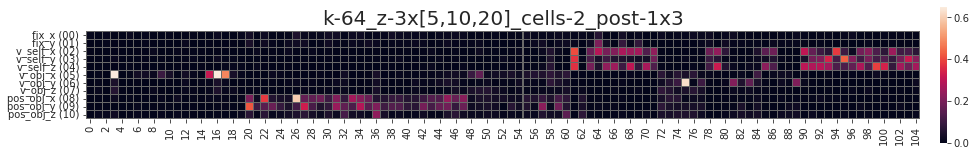

fig/hist_z

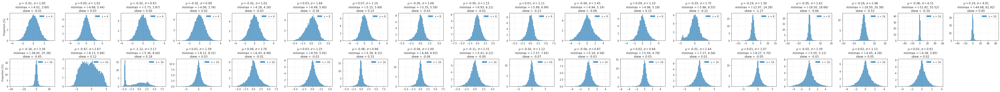

fig/hist_x_sample

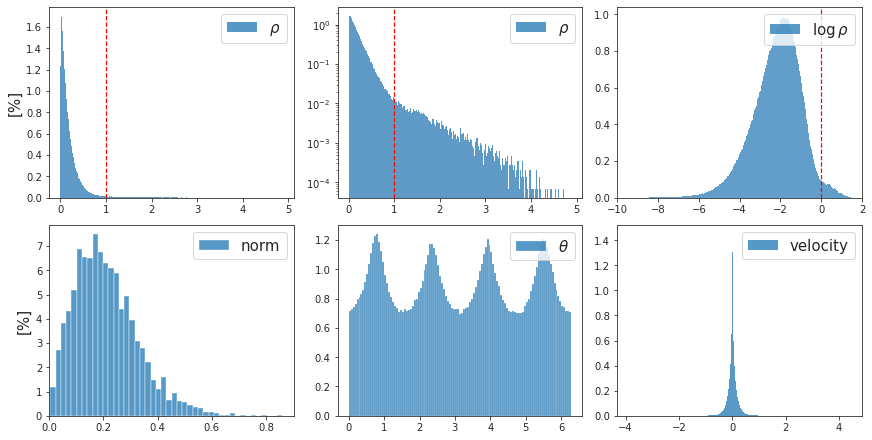

In [15]:
for k, v in val.items():
    if 'fig' in k:
        print(k)
        display(v)

In [22]:
names = tr.dl_tst.dataset.factor_names
_tx = [f"({i:02d})" for i in range(len(names))]
_ty = [f"{e} ({i:02d})" for i, e in names.items()]

In [29]:
fig, _ = show_heatmap(
    r=val['regr/mi'],
    yticklabels=_ty,
    title=f"{tr.model.cfg.name()}",
    tick_labelsize_y=10,
    title_fontsize=20,
    vmin=0,
    vmax=0.65,
    cmap='rocket',
    linecolor='dimgrey',
    cbar_kws={'pad': 0.02},
    figsize=(20, 2.5),
    annot=False,
    display=False,
)

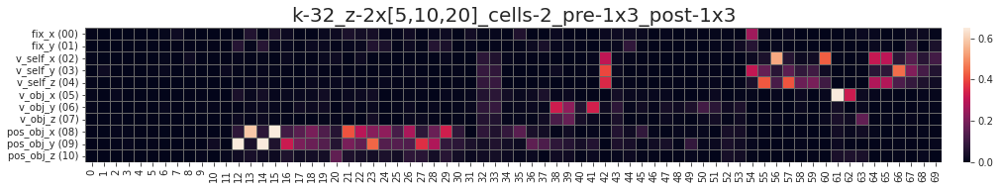

In [30]:
fig

fig/sample

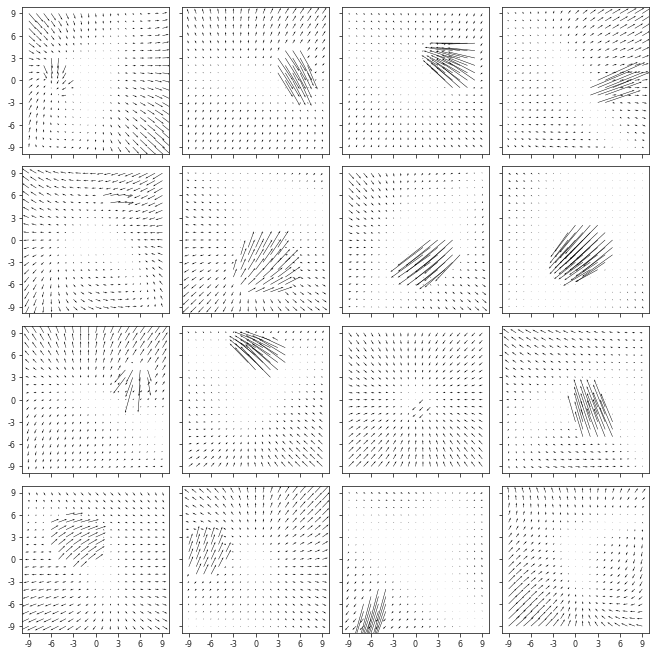

fig/corr_z

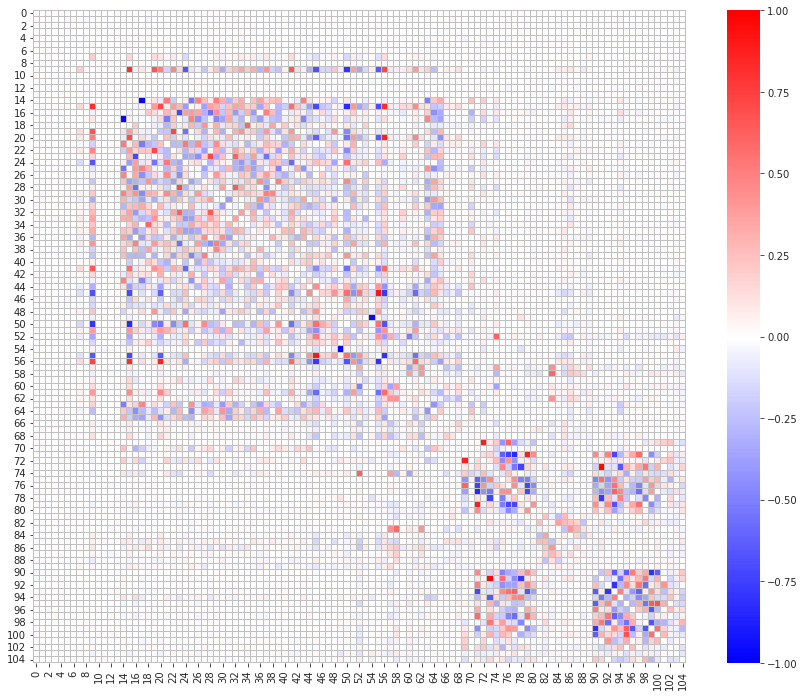

fig/regression

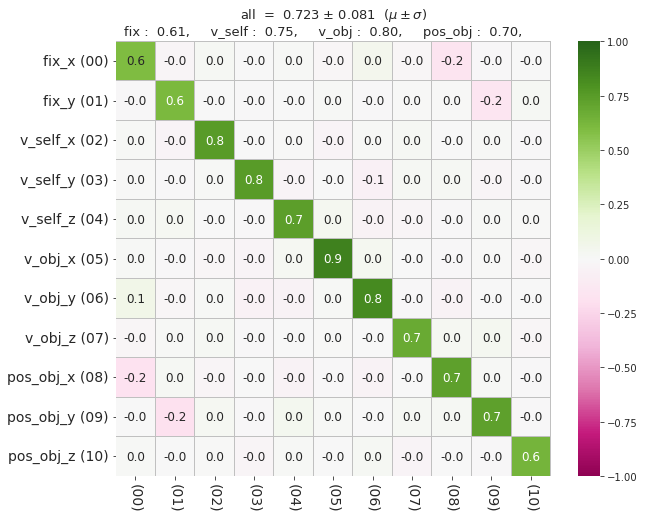

fig/mutual_info

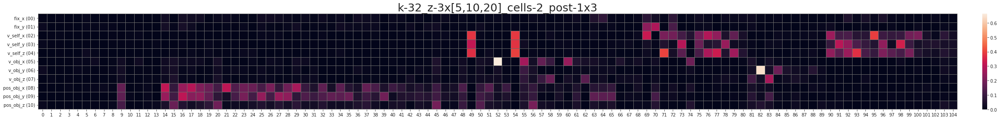

fig/hist_z

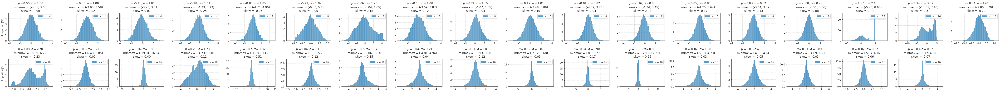

fig/hist_x_sample

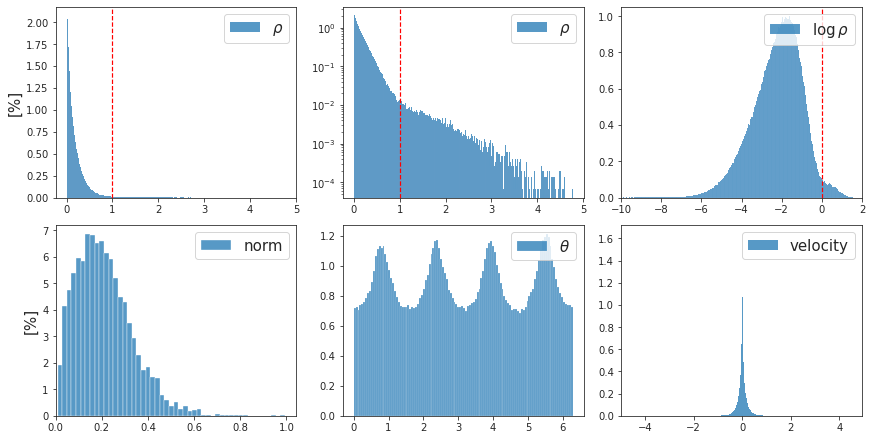

fig/sample

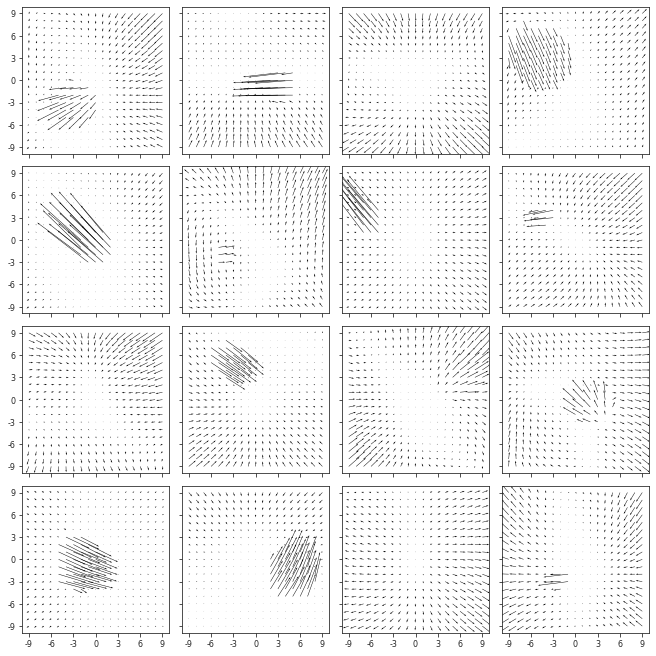

fig/corr_z

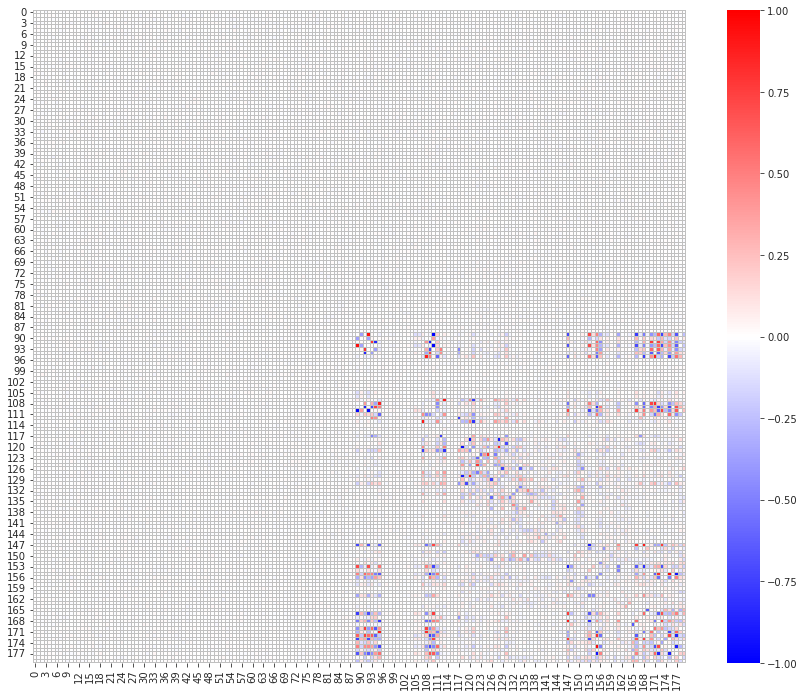

fig/regression

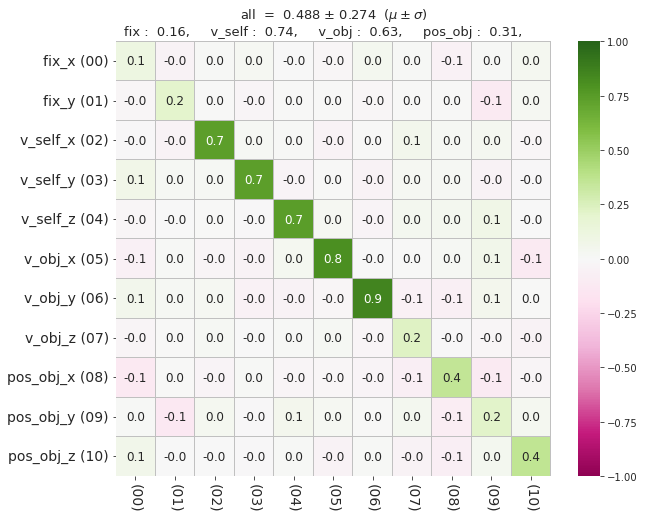

fig/mutual_info

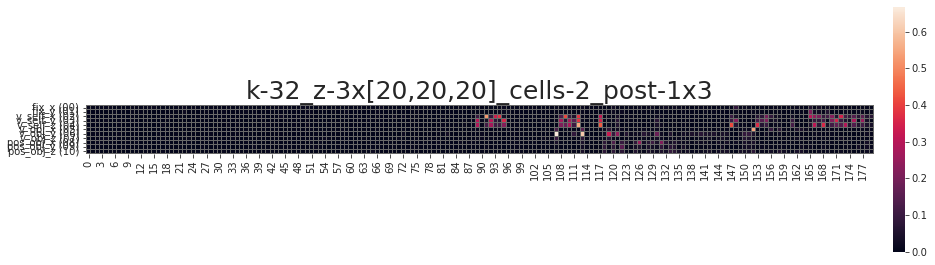

fig/hist_z

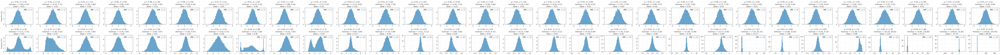

fig/hist_x_sample

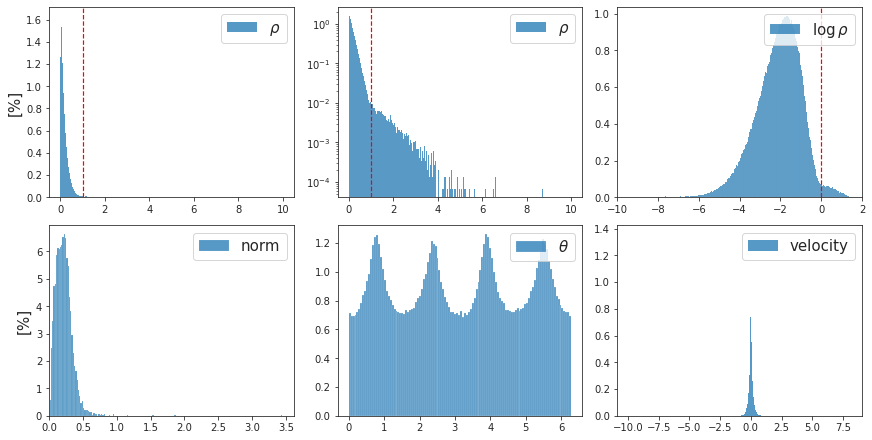

fig/sample

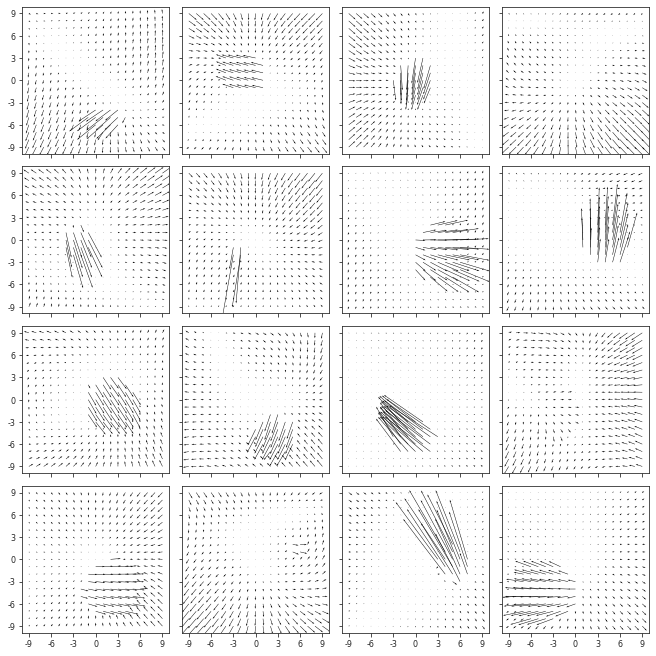

fig/corr_z

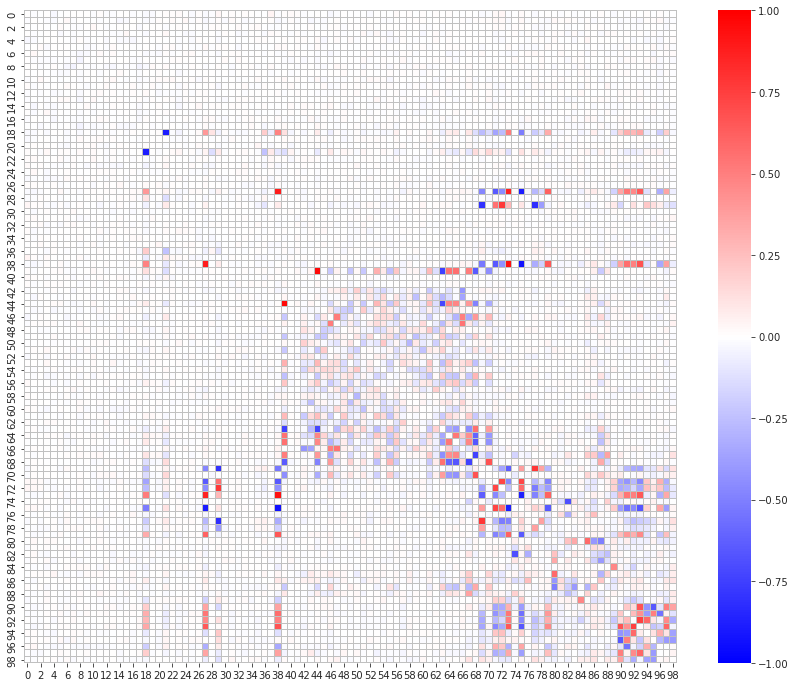

fig/regression

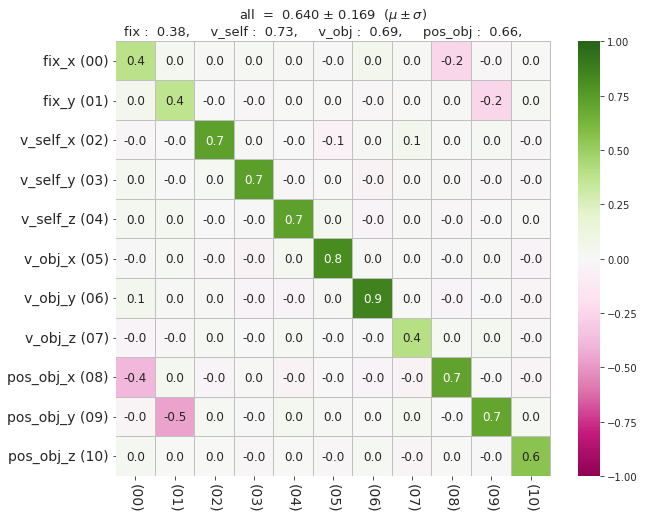

fig/mutual_info

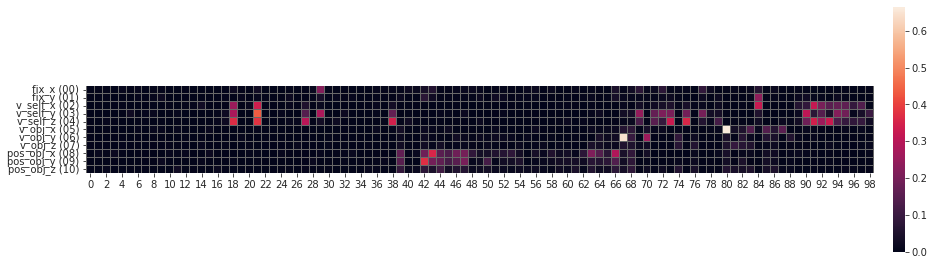

fig/hist_z

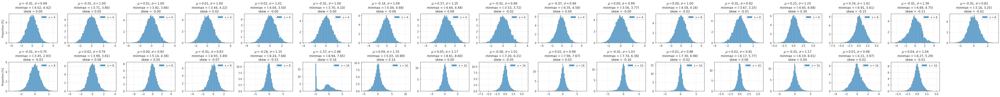

fig/hist_x_sample

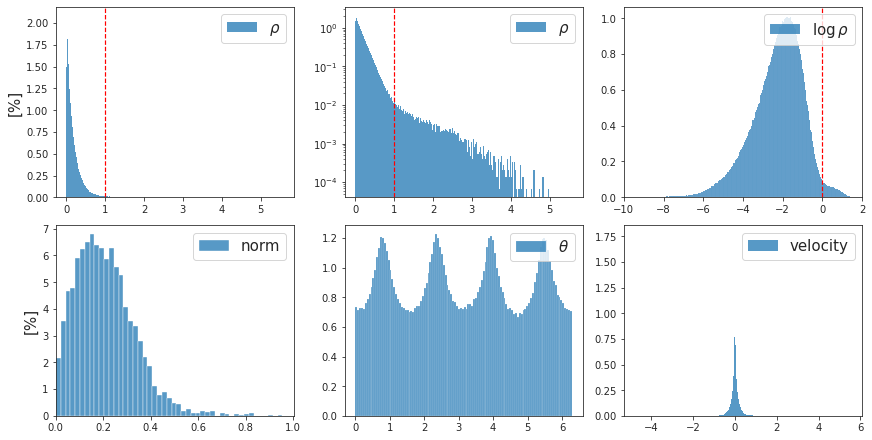

In [15]:
from model.vae2d import *

In [16]:
norms = collections.defaultdict(list)
# norms['stem'] = list(to_np(vae.stem.log_weight_norm.exp()))
for cell in vae.enc_tower:
    for m in cell.modules():
        if hasattr(m, 'log_weight_norm'):
            norms[f"{type(cell).__name__}_enc"].extend(
                list(to_np(m.log_weight_norm.exp())))
for cell in vae.dec_tower:
    for m in cell.modules():
        if hasattr(m, 'log_weight_norm'):
            norms[f"{type(cell).__name__}_dec"].extend(
                list(to_np(m.log_weight_norm.exp())))
for cell in vae.enc_sampler:
    for m in cell.modules():
        if hasattr(m, 'log_weight_norm'):
            norms['enc_sampler'].extend(
                list(to_np(m.log_weight_norm.exp())))
for cell in vae.dec_sampler:
    for m in cell.modules():
        if hasattr(m, 'log_weight_norm'):
            norms['dec_sampler'].extend(
                list(to_np(m.log_weight_norm.exp())))
for cell in vae.expand:
    for m in cell.modules():
        if hasattr(m, 'log_weight_norm'):
            norms['expand'].extend(
                list(to_np(m.log_weight_norm.exp())))
for cell in vae.post:
    for m in cell.modules():
        if hasattr(m, 'log_weight_norm'):
            norms[f"{type(cell).__name__}_post"].extend(
                list(to_np(m.log_weight_norm.exp())))
norms = dict(sorted(norms.items()))

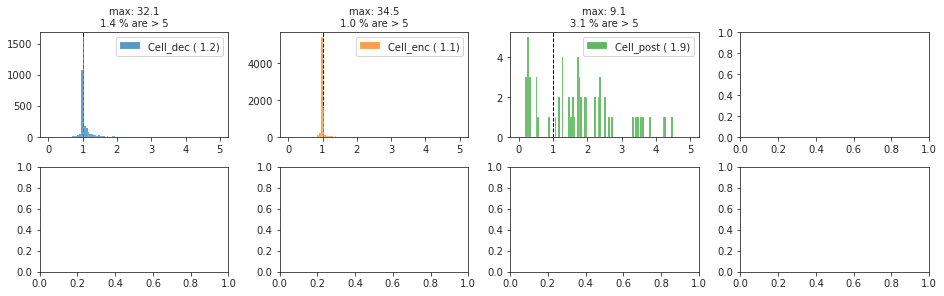

In [17]:
fig, axes = create_figure(2, 4, (13, 4), constrained_layout=True)
for i, (k, v) in enumerate(norms.items()):
    ax = axes.flat[i]
    ax.axvline(1, color='k', ls='--', lw=1.0, zorder=0)
    sns.histplot(v, color=f"C{i}", bins=np.linspace(0, 5, 101), label=f"{k} ({np.mean(v): 0.1f})", ax=ax)
    title = f"max: {np.max(v):0.1f}\n{100 * (np.array(v) > 5).sum() / len(v):0.1f} % are > 5"
    ax.set_title(title, fontsize=10)
    ax.set_ylabel('')
    ax.legend()
plt.show()

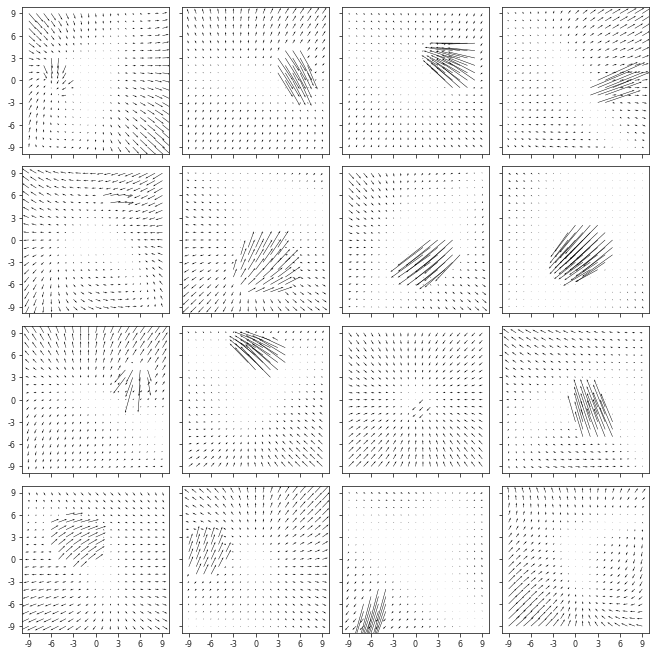

In [18]:
_ = show_opticflow(val['x_sample'])

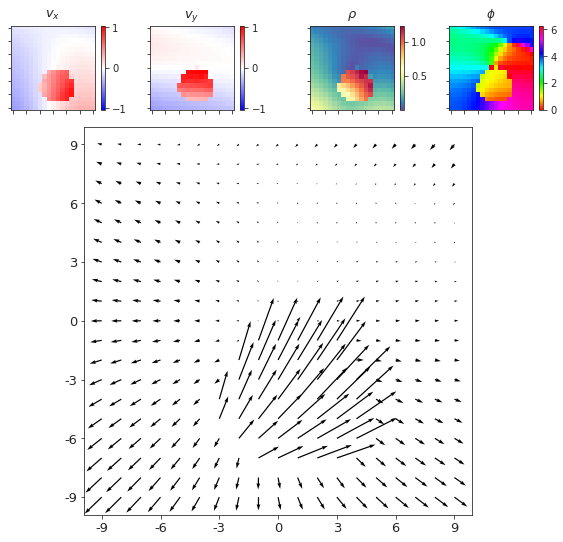

In [34]:
_ = show_opticflow_full(val['x_sample'][5])

In [57]:
with torch.no_grad():
    x_sam, z_sam, _ = vae.sample(n=16, t=2, device=tr.device)

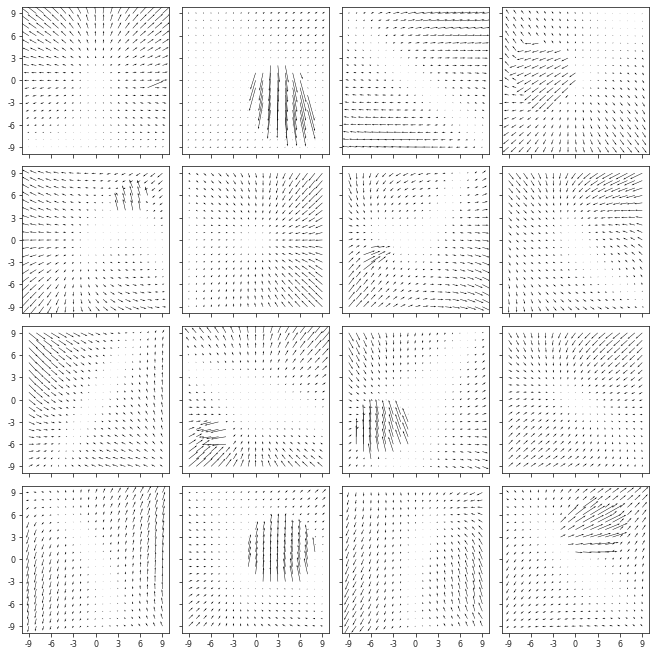

In [58]:
show_opticflow(x_sam);

In [59]:
w = to_np(vae.stem.weight)
w.shape

(32, 2, 4, 4)

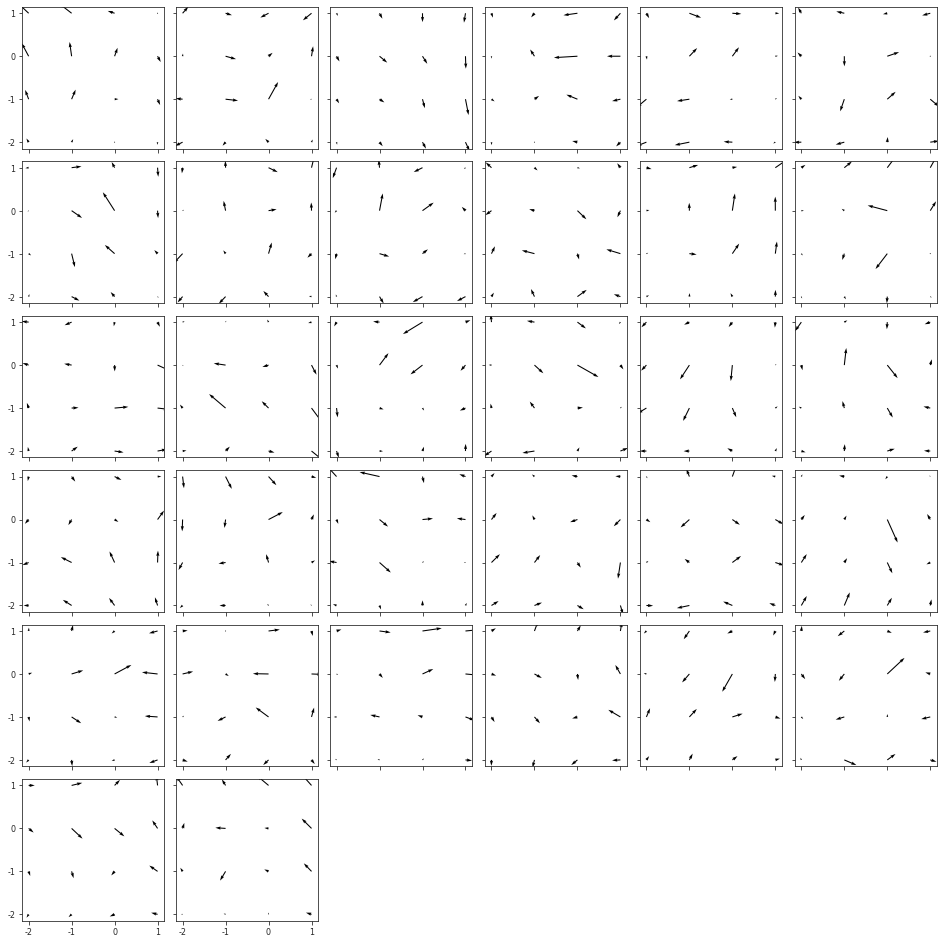

In [60]:
_ = show_opticflow(w, 6, figsize=(13,) * 2, tick_spacing=1)

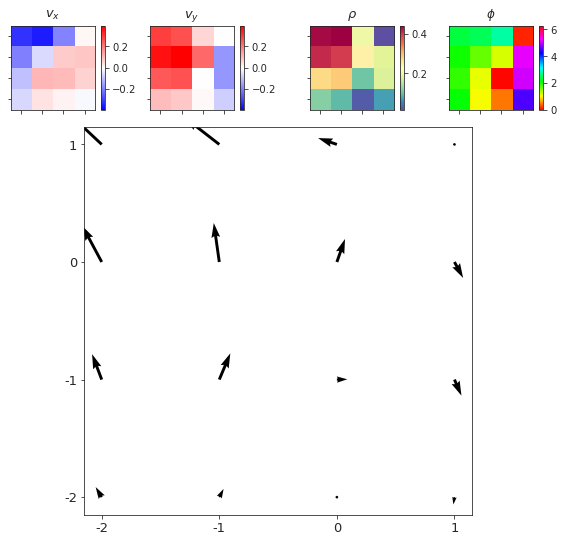

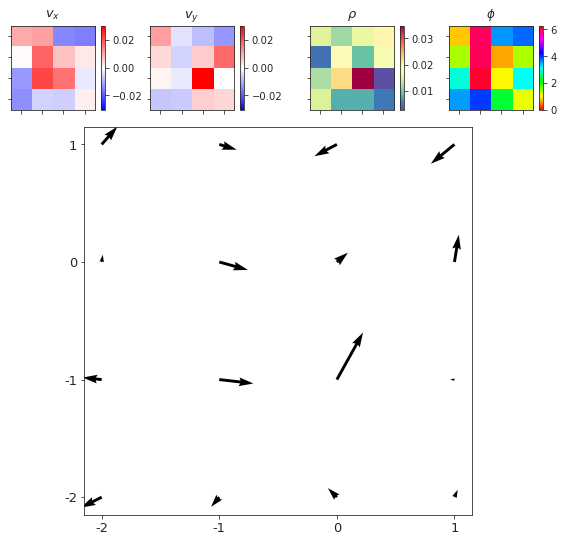

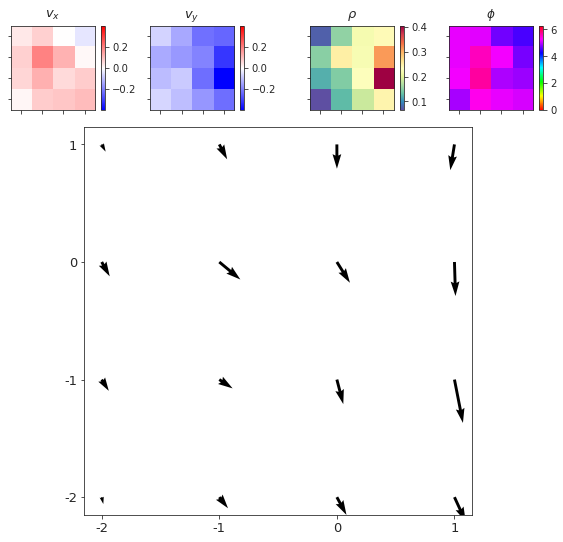

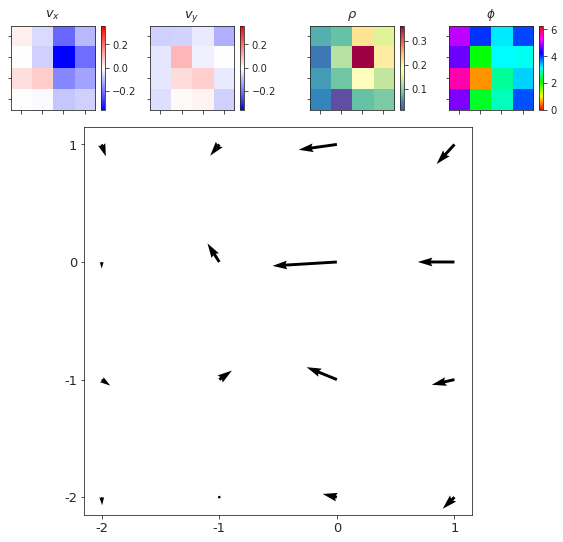

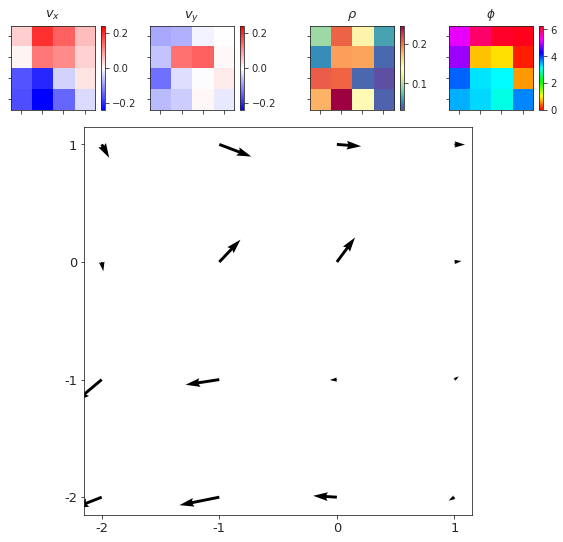

...

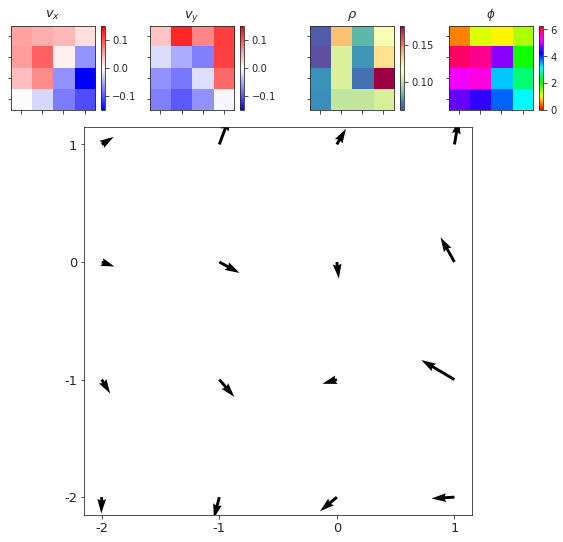

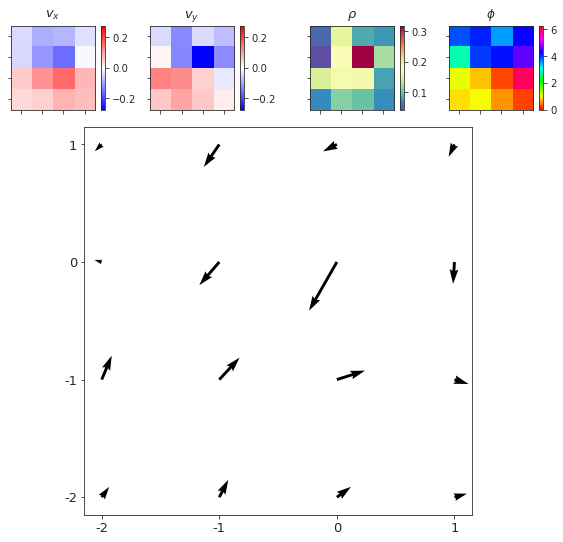

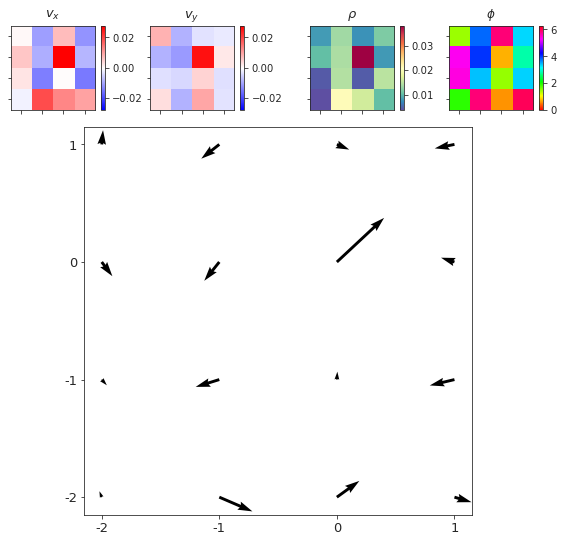

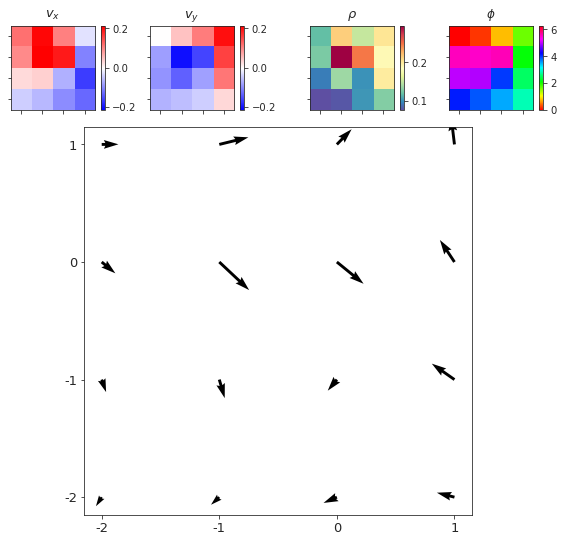

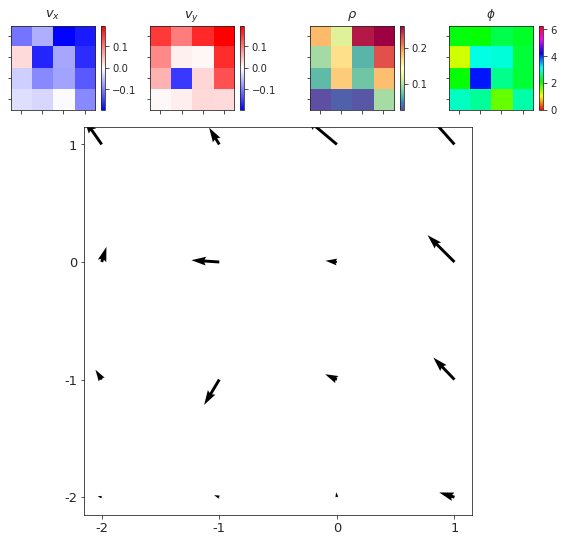

In [61]:
for k in range(len(w)):
    _ = show_opticflow_full(w[k], tick_spacing=1)

In [65]:
x_sample, z_sample = val['x_sample'], val['z_sample']

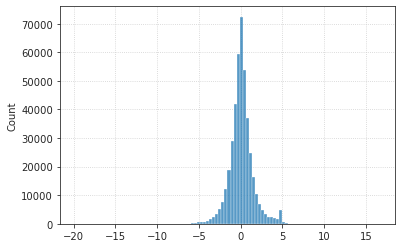

In [66]:
ax = sns.histplot(z_sample.ravel(), bins=100)
ax.grid()

In [67]:
scales, _ = vae.latent_scales()

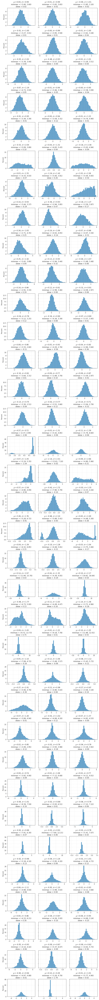

In [68]:
_ = plot_latents_hist_full(z_sample, scales)

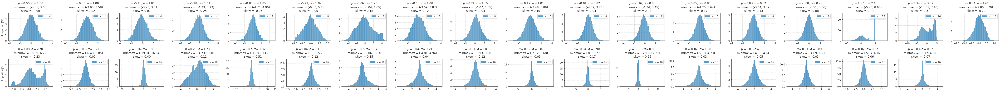

In [69]:
plot_latents_hist(z_sample, scales);

In [70]:
ticks = [
    i for i in range(tr.model.cfg.total_latents())
    if i % tr.model.cfg.n_latent_per_group == 0
]
ticklabels = [i + 1 for i in ticks]

In [71]:
val['z_sample'].shape

(4096, 105)

In [72]:
u, s, v = sp_lin.svd(val['z_vld'], full_matrices=False, compute_uv=True)
s *= 100 / s.sum()
u.shape, s.shape, v.shape

((7500, 105), (105,), (105, 105))

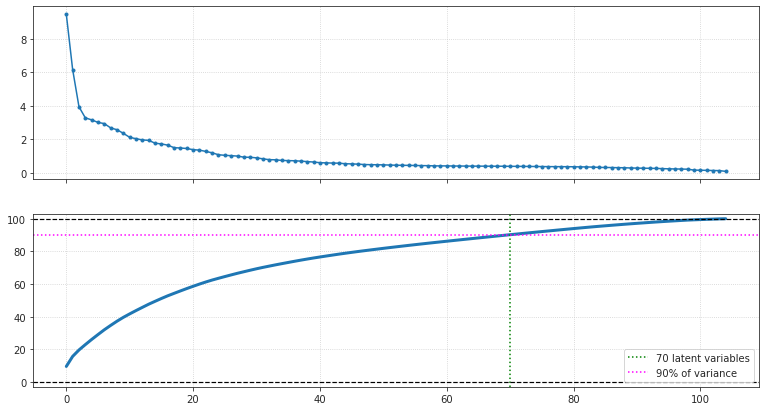

In [73]:
fig, axes = create_figure(2, 1, (13, 7), sharex='all')
axes[0].plot(s, marker='.')
axes[1].plot(np.cumsum(s), lw=3, marker=None)

thres = 90
idx = np.where(np.cumsum(s) > thres)[0][0]
axes[1].axvline(
    idx, color='g', ls=':', lw=1.5,
    label=f'{idx} latent variables',
)
axes[1].axhline(
    thres, color='magenta', ls=':', lw=1.5,
    label=f'{thres}% of variance',
)
axes[1].legend()

axes[1].axhline(0, color='k', ls='--', lw=1.2)
axes[1].axhline(100, color='k', ls='--', lw=1.2)
axes[1].set_ylim((-3, 103))
add_grid(axes)
plt.show()


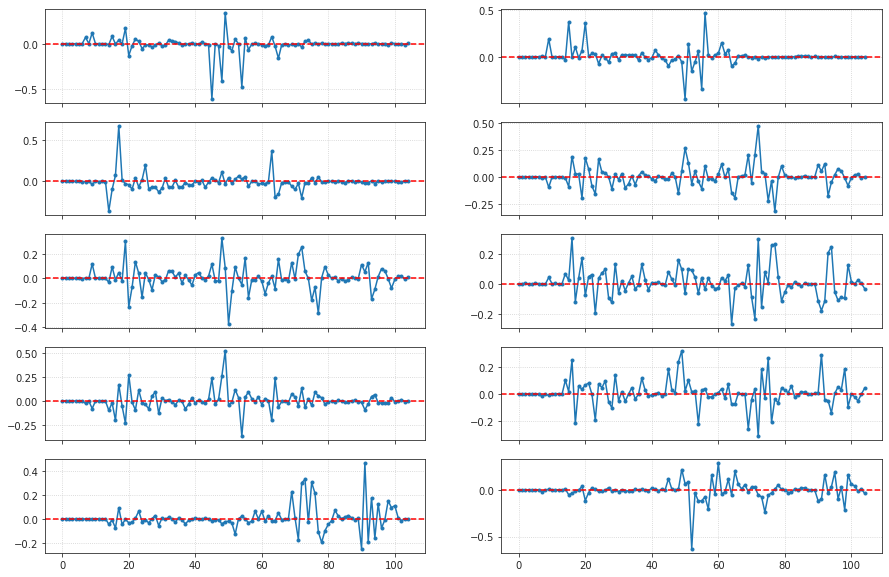

In [77]:
fig, axes = create_figure(5, 2, (15, 10), 'all')
for i, ax in enumerate(axes.flat):
    ax.plot(v[i], marker='.')
    ax.axhline(0, color='r', ls='--')
    # ax.set(xticks=ticks, xticklabels=ticklabels)
    # ax.tick_params(axis='x', rotation=-90)
    ax.grid()
plt.show()

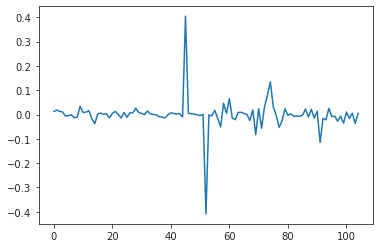

In [86]:
plt.plot(val['regr/lr'].coef_[5])

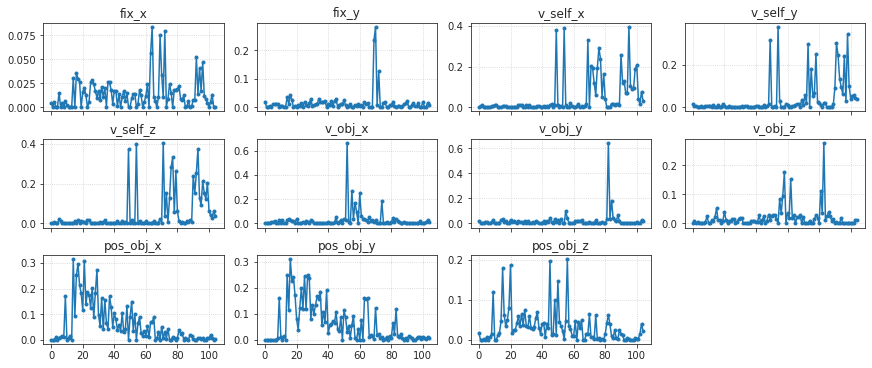

In [90]:
fig, axes = create_figure(3, 4, (12, 5), 'all', 'none', constrained_layout=True)
for i in range(11):
    ax = axes.flat[i]
    ax.plot(val['regr/mi'][i], marker='.')
    ax.set_title(tr.dl_tst.dataset.factor_names[i])
    ax.grid()
trim_axs(axes, 11)
plt.show()

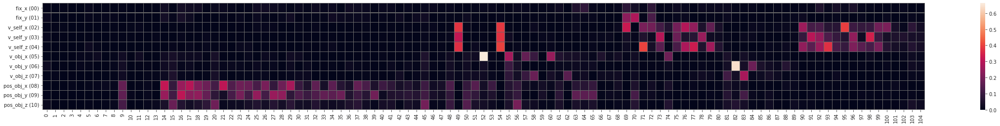

In [91]:
fig, ax = create_figure(figsize=(40, 4))
sns.heatmap(val['regr/mi'], vmin=0, linewidth=0.01, linecolor='dimgrey')
ax.set_yticklabels([f"{e} ({i:02d})" for i, e in tr.dl_tst.dataset.factor_names.items()])
ax.tick_params(axis='y', rotation=0)
plt.show()

In [93]:
from sklearn.feature_selection import mutual_info_regression

In [96]:
list(val)

['x_sample',
 'z_sample',
 'z_vld',
 'z_tst',
 'g_vld',
 'g_tst',
 'regr/mi',
 'regr/r',
 'regr/lr',
 'fig/sample',
 'fig/corr_z',
 'fig/regression',
 'fig/mutual_info',
 'fig/hist_z',
 'fig/hist_x_sample']

In [99]:
.shape

(7500, 3)

In [103]:
v = cart2polar(val['g_vld'][:, 2:5])
mi_emerg = mutual_info_regression(val['z_vld'], v[:, 0])
mi_emerg.shape

(105,)

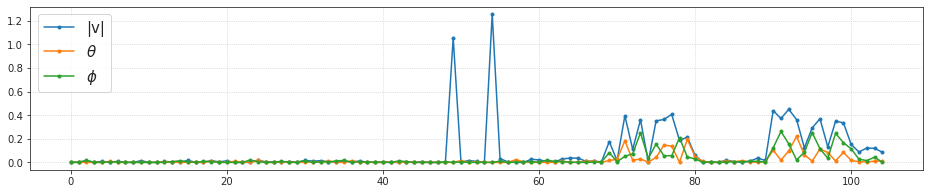

In [112]:
fig, ax = create_figure(1, 1, (16, 3), 'all', 'all')
for i, lbl in enumerate(['|v|', r'$\theta$', r'$\phi$']):
    mi_emerg = mutual_info_regression(val['z_vld'], v[:, i])
    ax.plot(mi_emerg, marker='.', label=lbl, color=f"C{i}")
    ax.legend(loc='upper left', fontsize=15)
    ax.grid()
plt.show()

In [113]:
w2p = {}
norms_expand = {}
for i, layer in enumerate(vae.expand):
    w2p[i] = to_np(layer.weight)
    _norm = to_np(torch.linalg.norm(layer.weight, dim=1).sum())
    norms_expand[i] = _norm
print({i: np.round(v, 3) for i, v in norms_expand.items()})

{
    0: 0.0,
    1: 0.002,
    2: 0.96,
    3: 6.6,
    4: 5.739,
    5: 38.121,
    6: 32.361,
    7: 16.307,
    8: 34.178,
    9: 30.464,
    10: 25.926,
    11: 30.723,
    12: 29.375,
    13: 27.634,
    14: 29.032,
    15: 130.255,
    16: 42.32,
    17: 74.465,
    18: 65.042,
    19: 109.096,
    20: 74.919,
    21: 48.921,
    22: 67.094,
    23: 89.74,
    24: 21.238,
    25: 77.769,
    26: 56.144,
    27: 102.395,
    28: 48.102,
    29: 55.759,
    30: 142.393,
    31: 84.059,
    32: 90.015,
    33: 61.814,
    34: 60.327
}

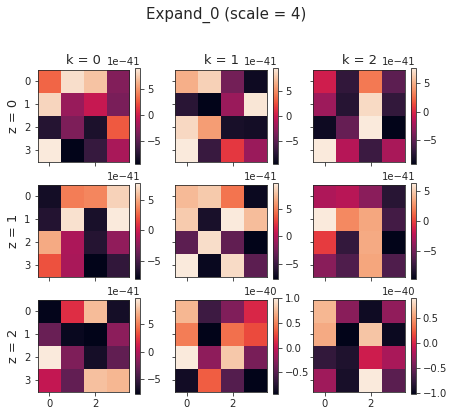

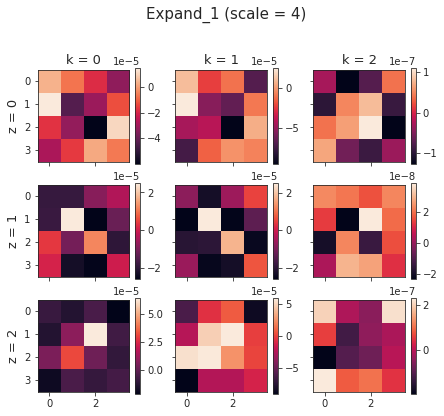

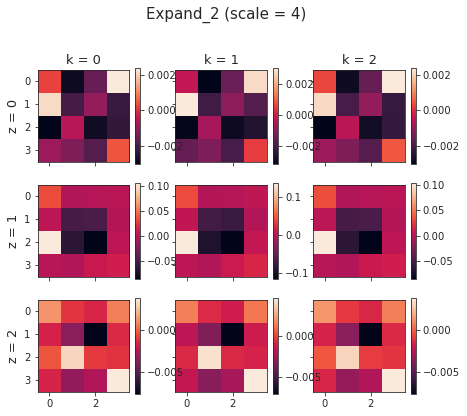

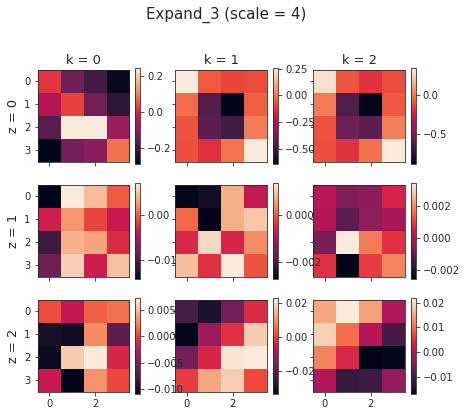

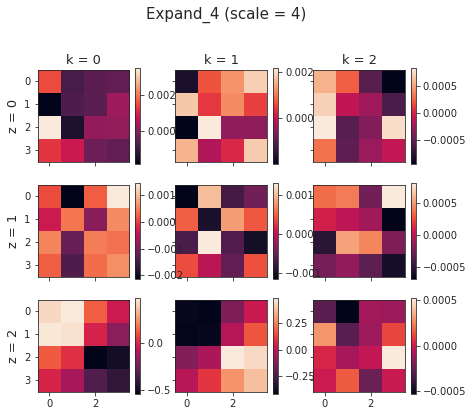

...

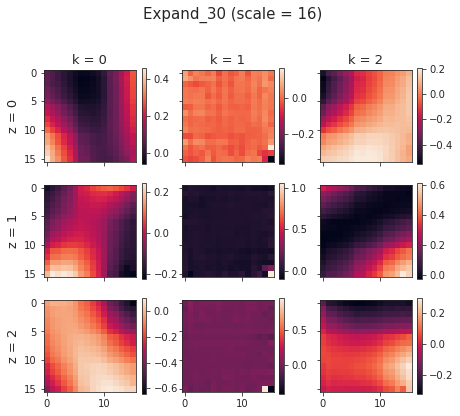

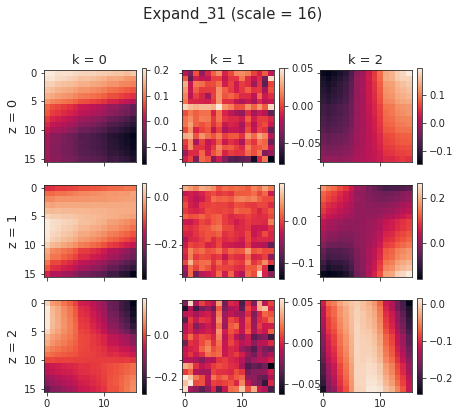

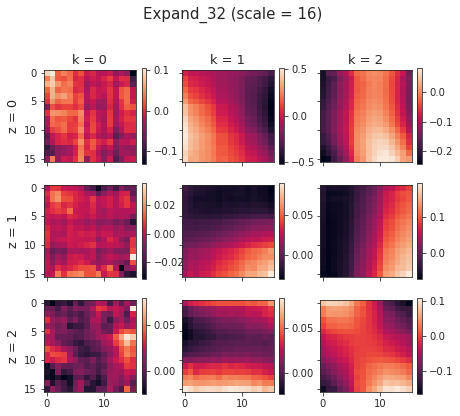

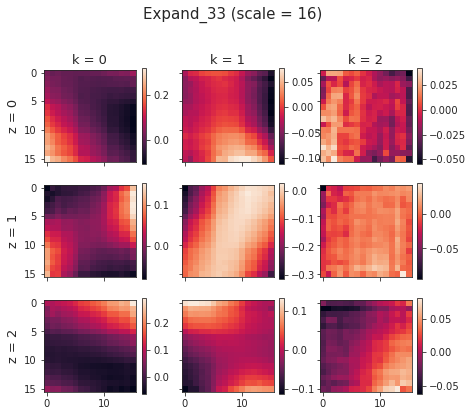

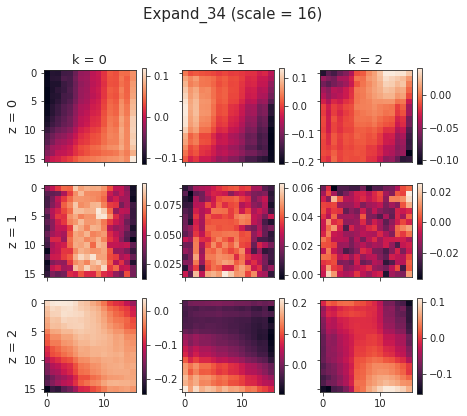

In [127]:
scales, _ = tr.model.latent_scales()
num = vae.cfg.n_latent_per_group

for i, _w in w2p.items():
    fig, axes = create_figure(num, num, (7, 6), 'all', 'all')
    for z, k in itertools.product(range(num), range(num)):
        ax = axes[z, k]
        im = ax.imshow(_w[z, k])
        plt.colorbar(im, ax=ax)
        if z == 0:
            ax.set_title(f"k = {k}", fontsize=13)
        if k == 0:
            ax.set_ylabel(f"z = {z}", fontsize=13)
    fig.suptitle(f'Expand_{i} (scale = {scales[i]})', fontsize=15, y=1.02)
    plt.show()

## Good, non-sep fit (Mar 12th, 20:33)

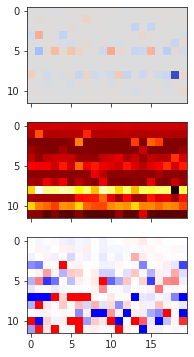

In [49]:
z = val['z_sample']
scales=vae.latent_scales()[0]
a = z.reshape((len(z), len(scales), -1))
nrows, ncols = a.shape[1:]
looper = itertools.product(
    range(nrows), range(ncols))
mu = np.zeros((nrows, ncols))
std = np.zeros((nrows, ncols))
skew = np.zeros((nrows, ncols))
for i, j in looper:
    x = a[:, i, j]
    mu[i, j] = x.mean()
    std[i, j] = x.std()
    skew[i, j] = sp_stats.skew(x)
    
    
fig, axes = create_figure(3, 1, (20, 6), 'all', 'all')
axes[0].imshow(mu, vmin=-3, vmax=3, cmap='coolwarm')
axes[1].imshow(std, vmin=0, cmap='hot')
axes[2].imshow(skew, vmin=-1, vmax=1, cmap='bwr')
plt.show()

In [50]:
np.abs(skew).mean()

1.0266989958051171

In [55]:
print(vae.cfg.get_name())

k-64_z-20x[4,4,4]_cells-3_post-1x3

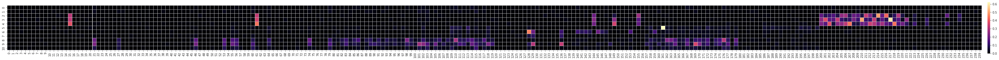

(<Figure size 5040x230.4 with 2 Axes>, <AxesSubplot:>)

In [53]:
show_heatmap(val['regr/mi'], vmin=0, vmax=None, cmap='magma',
             annot=False, cbar_kws={'pad': 0.005}, figsize=(70, 3.2))

In [56]:
val['regr/mi'].shape

(11, 240)

In [57]:
mi = val['regr/mi']
mi.shape

(11, 240)

In [58]:
scales, level_ids = vae.latent_scales()

In [59]:
level_ids

{'group-0_scale-4_0': range(0, 20),
 'group-1_scale-4_1': range(20, 40),
 'group-2_scale-4_2': range(40, 60),
 'group-3_scale-4_3': range(60, 80),
 'group-4_scale-8_0': range(80, 100),
 'group-5_scale-8_1': range(100, 120),
 'group-6_scale-8_2': range(120, 140),
 'group-7_scale-8_3': range(140, 160),
 'group-8_scale-16_0': range(160, 180),
 'group-9_scale-16_1': range(180, 200),
 'group-10_scale-16_2': range(200, 220),
 'group-11_scale-16_3': range(220, 240)}

In [60]:
mi_scales = np.zeros((len(mi), len(level_ids)))
for j, (key, ids) in enumerate(level_ids.items()):
    for i, x in enumerate(mi):
        mi_scales[i, j] = x[ids].sum() / x.sum()
mi_scales.shape

(11, 12)

In [61]:
names = tr.dl_tst.dataset.factor_names
_ty = [f"{e} ({i:02d})" for i, e in names.items()]
_tx = [e.split('_')[1] for e in level_ids]

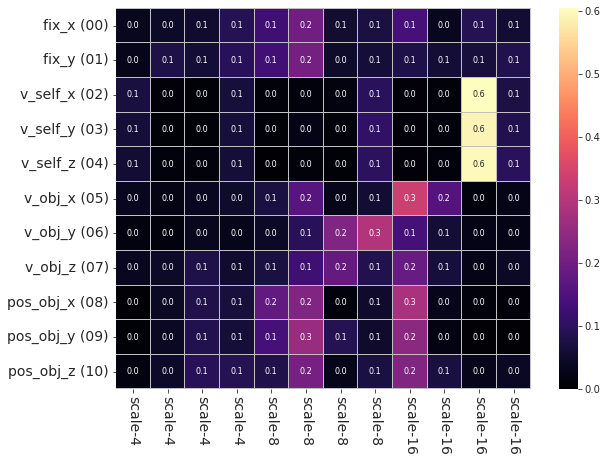

In [64]:
show_heatmap(
    r=mi_scales,
    vmin=0,
    vmax=None,
    yticklabels=_ty,
    xticklabels=_tx,
    cmap='magma',
    figsize=(10, 7),
);

In [65]:
mi_scales2 = np.zeros((len(mi), len(vae.cfg.groups)))
for j, s in enumerate(np.unique(scales)):
    _ids = []
    for k, ids in level_ids.items():
        if f'scale-{s}' in k:
            _ids.extend(list(ids))
    for i, x in enumerate(mi):
        mi_scales2[i, j] = x[_ids].sum() / x.sum()

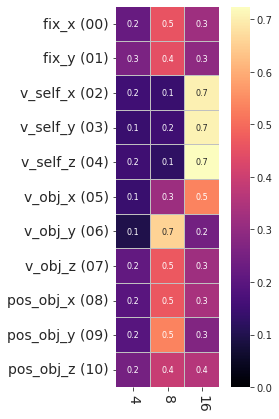

In [66]:
show_heatmap(
    r=mi_scales2,
    vmin=0,
    vmax=None,
    yticklabels=_ty,
    xticklabels=np.unique(scales),
    cmap='magma',
    figsize=(4, 7),
);

In [67]:
x, norm = next(iter(tr.dl_tst))
x, norm = tr.to([x, norm])
w = 1 / norm

In [68]:
tr.model.eval();
with torch.no_grad():
    y, *_ = tr.model(x)

In [69]:
l1 = tr.model.l1_recon(x, y)
l1 = torch.sum(l1, dim=[1, 2, 3])
l1_bal = l1 * w / w.mean()
l1_bal = to_np(l1_bal)
l1 = to_np(l1)
l1.shape

(256,)

In [70]:
np.argmax(l1)

150

In [71]:
np.argmax(l1_bal)

150

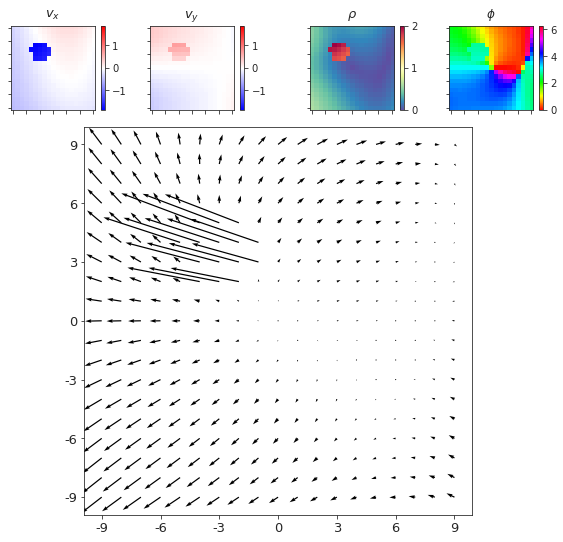

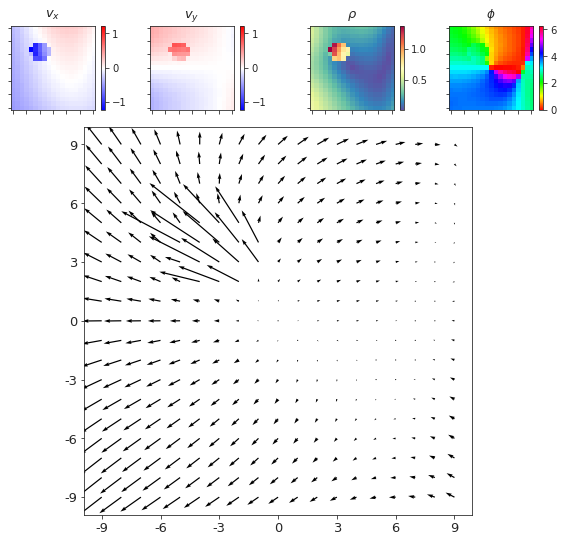

In [72]:
i = 150
show_opticflow_full(x[i])
show_opticflow_full(y[i]);

In [73]:
epe = endpoint_error(x, y)
epe_bal = epe * w / w.mean()
epe_bal = to_np(epe_bal)
np.argmax(epe_bal)

150

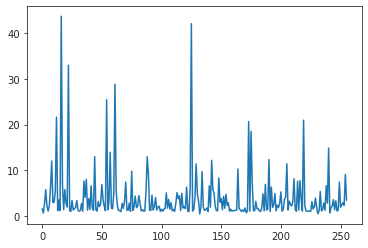

In [75]:
cos = 1 - tr.model.cos_recon(x, y)
cos = torch.sum(cos, dim=[1, 2])
cos = to_np(cos)
plt.plot(cos);

In [76]:
np.argmax(cos)

16

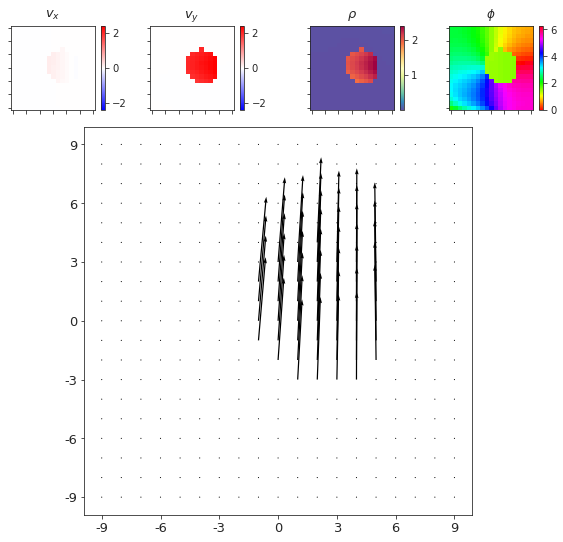

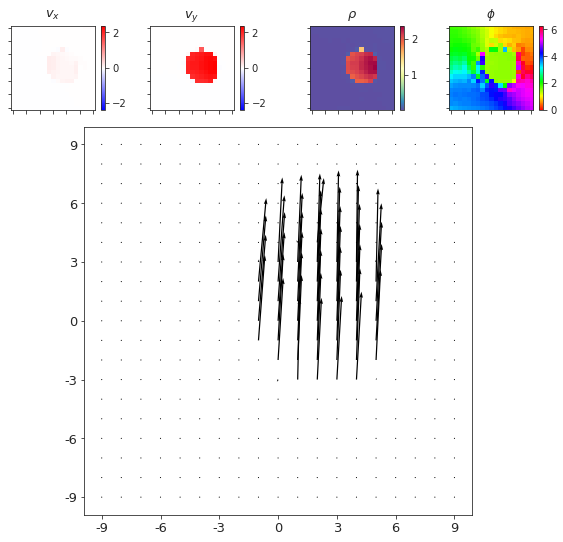

In [77]:
i = 16
show_opticflow_full(x[i])
show_opticflow_full(y[i]);

In [78]:
l2_true = vae.l2_recon(x, y)
l2_true = torch.sum(l2_true, dim=[1, 2, 3])
l2_true = l2_true * w / w.mean()
l2_true = to_np(l2_true)
l2_true.sum()

44.33539

In [79]:
l1_bal.sum(), l2_true.sum(), epe_bal.sum(), cos.sum()

(125.824524, 44.33539, 473.83505, 1029.465)

In [87]:
np.argsort(epe_bal)[:10]

array([191,  66,  86, 213, 122, 139, 212, 222, 206, 116])

In [81]:
epe_bal[191], epe[191]

(0.5211008, tensor(0.3873, device='cuda:0'))

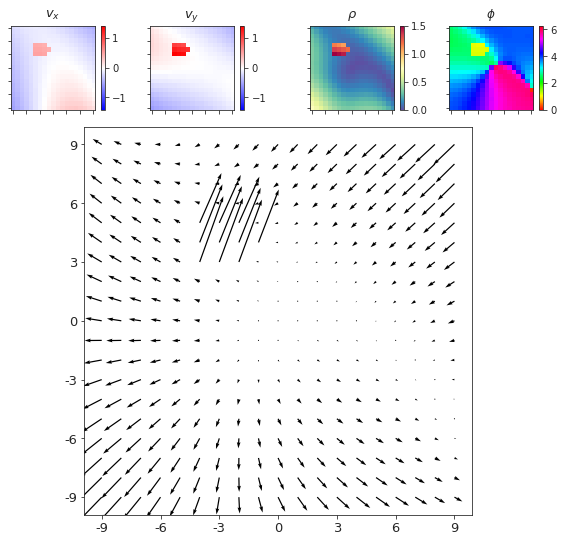

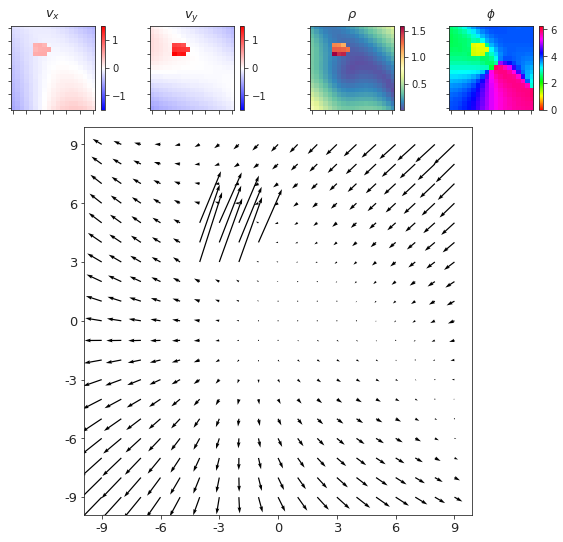

In [90]:
i = 206
show_opticflow_full(x[i])
show_opticflow_full(y[i]);

In [91]:
np.argsort(epe_bal)[-2]

29

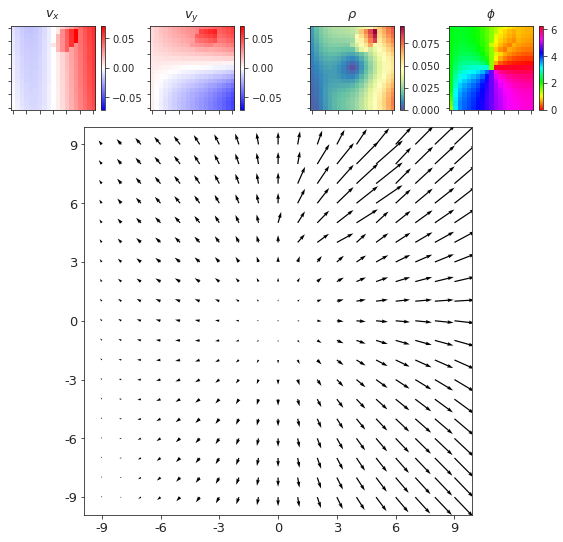

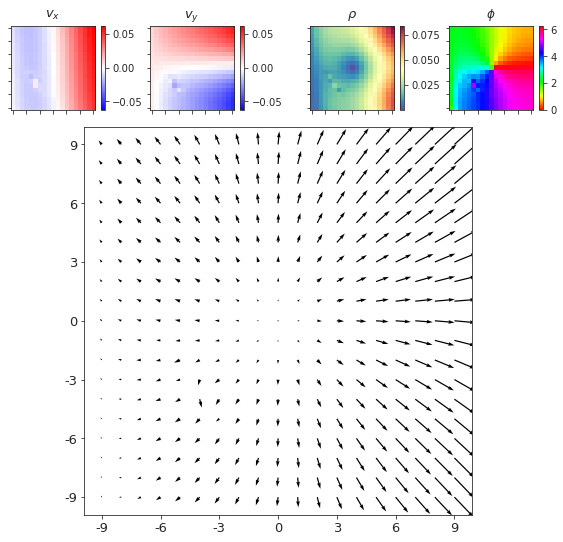

In [93]:
i = 29
show_opticflow_full(x[i])
show_opticflow_full(y[i]);

In [94]:
np.argmin(cos)

132

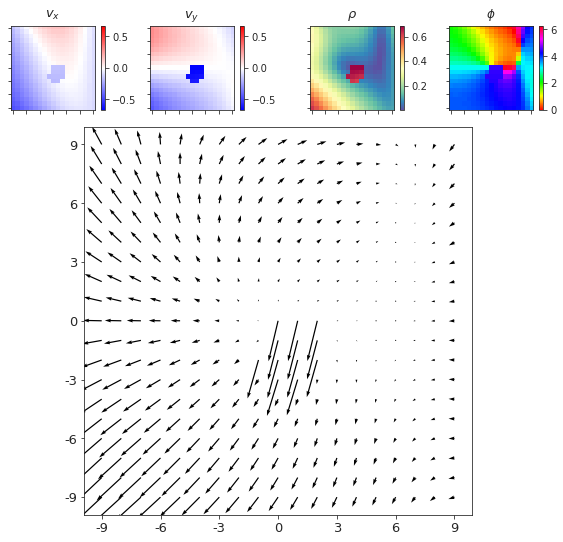

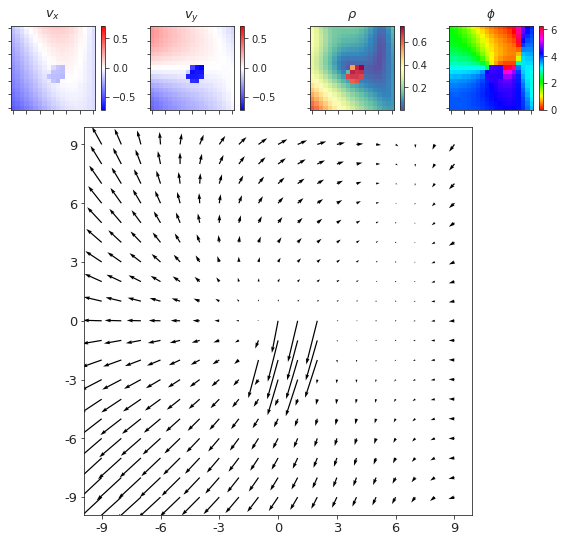

In [96]:
i = 132
show_opticflow_full(x[i])
show_opticflow_full(y[i]);

In [97]:
w2p = {}
norms_expand = {}
for i, layer in enumerate(vae.expand):
    w2p[i] = to_np(layer.weight)
    _norm = to_np(torch.linalg.norm(layer.weight, dim=1).sum())
    norms_expand[i] = _norm
print({i: np.round(v, 3) for i, v in norms_expand.items()})

{
    0: 5.647,
    1: 6.874,
    2: 13.689,
    3: 15.087,
    4: 39.761,
    5: 43.576,
    6: 20.835,
    7: 38.895,
    8: 257.296,
    9: 37.206,
    10: 105.081,
    11: 84.12
}

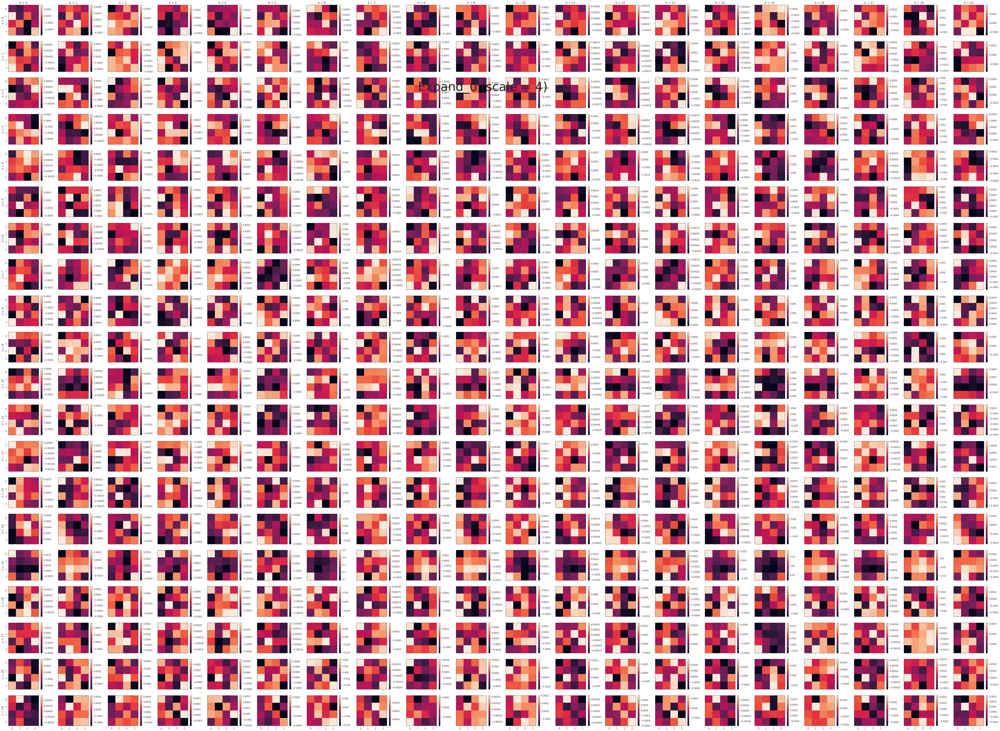

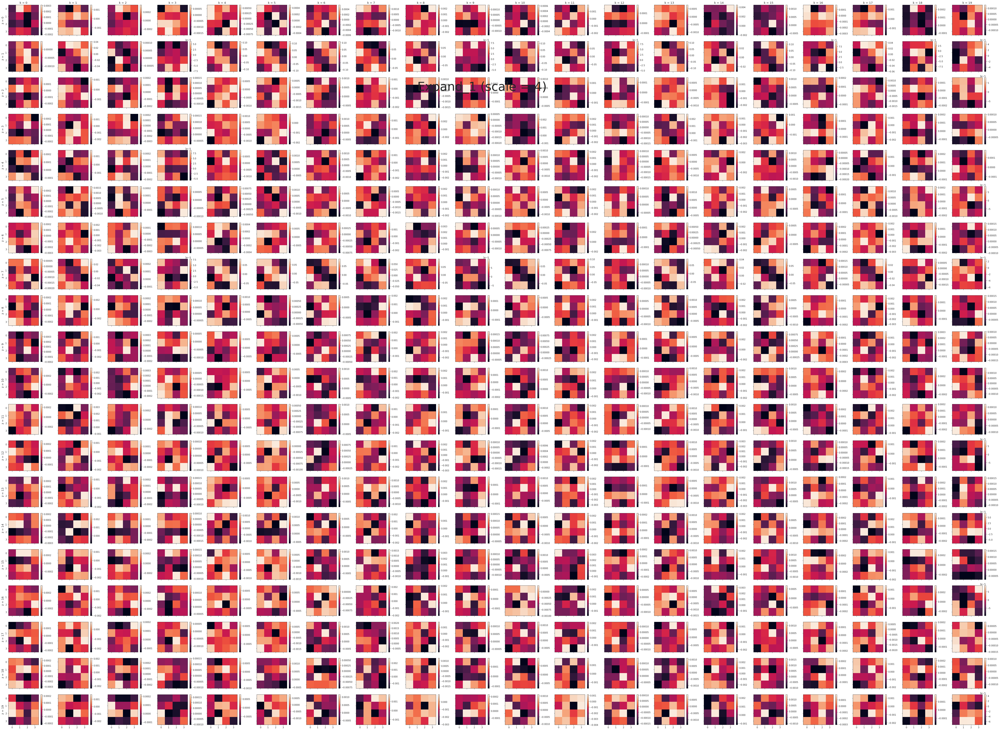

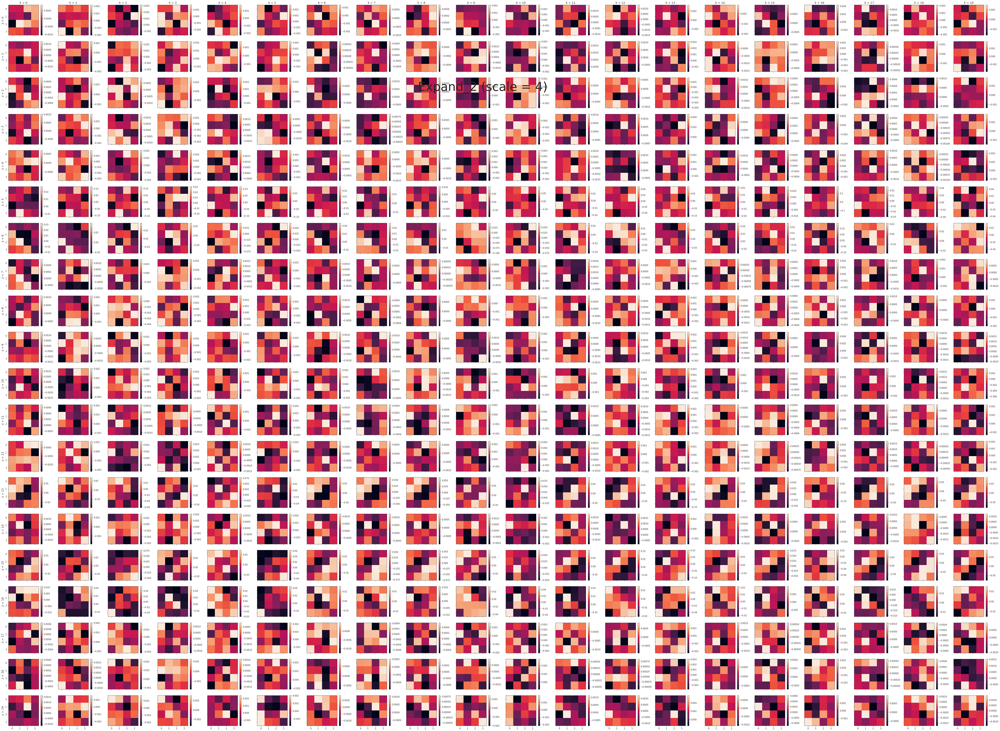

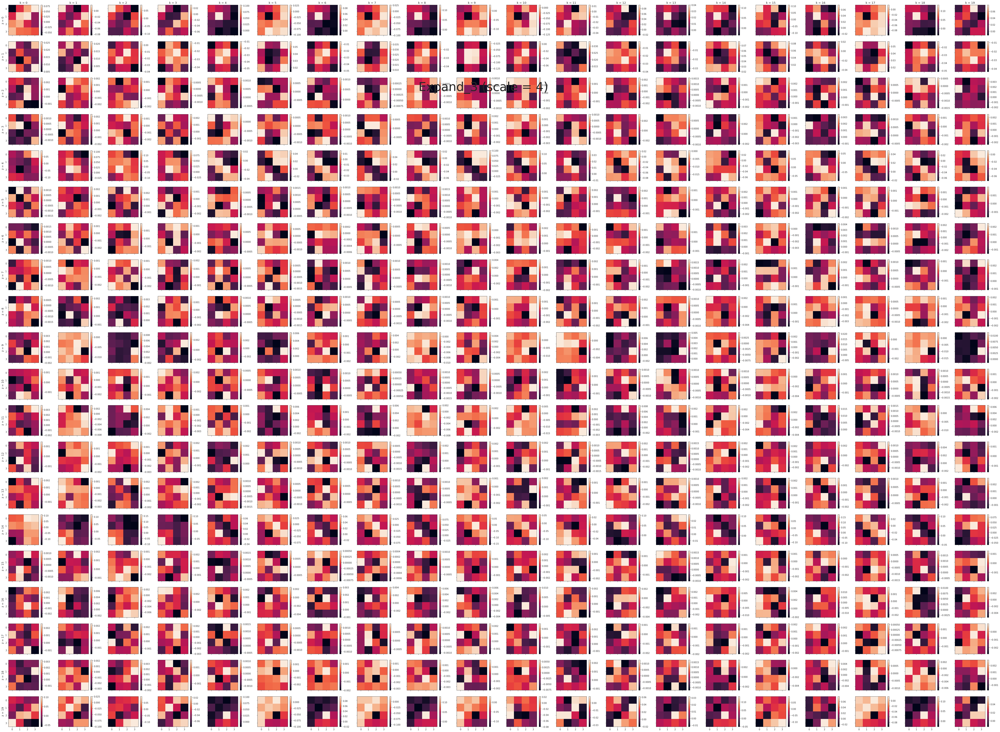

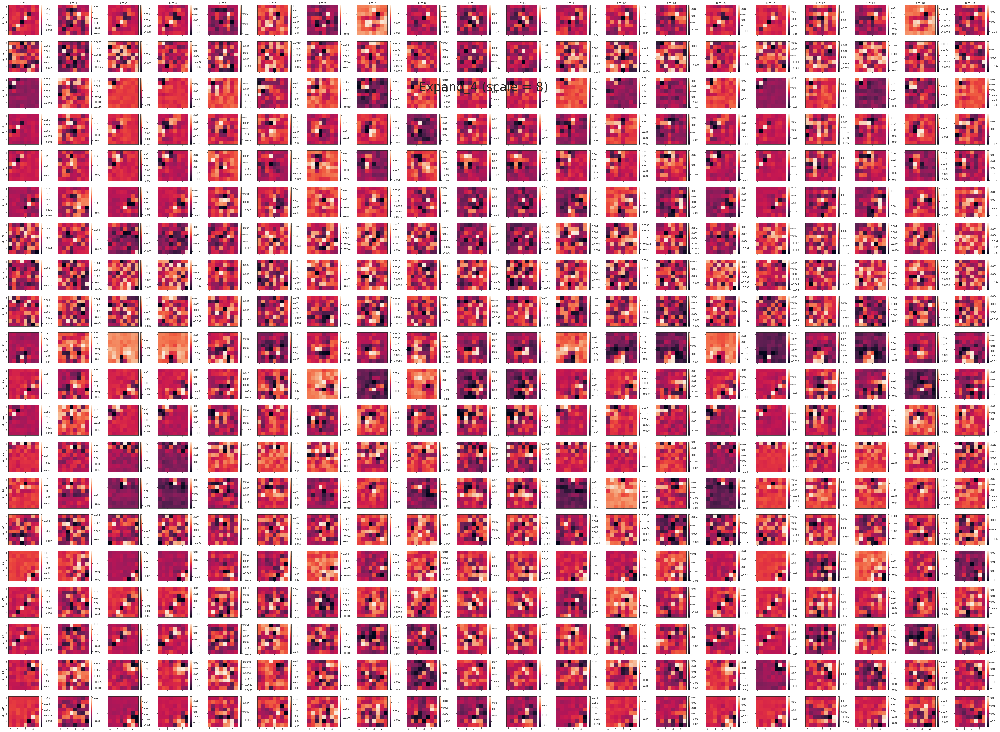

...

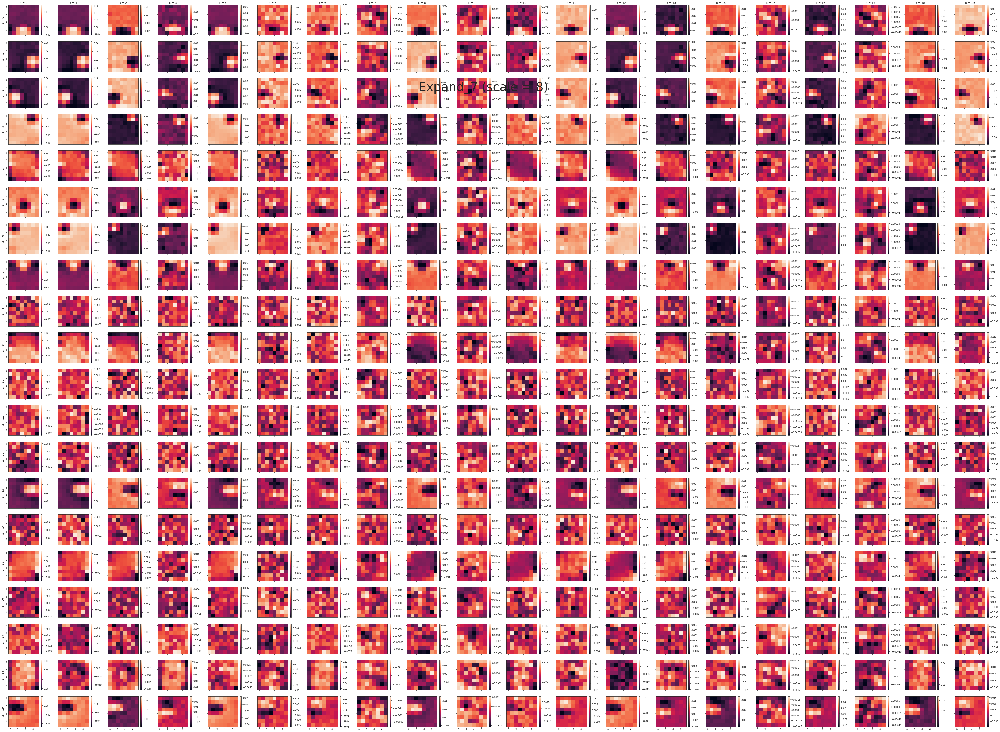

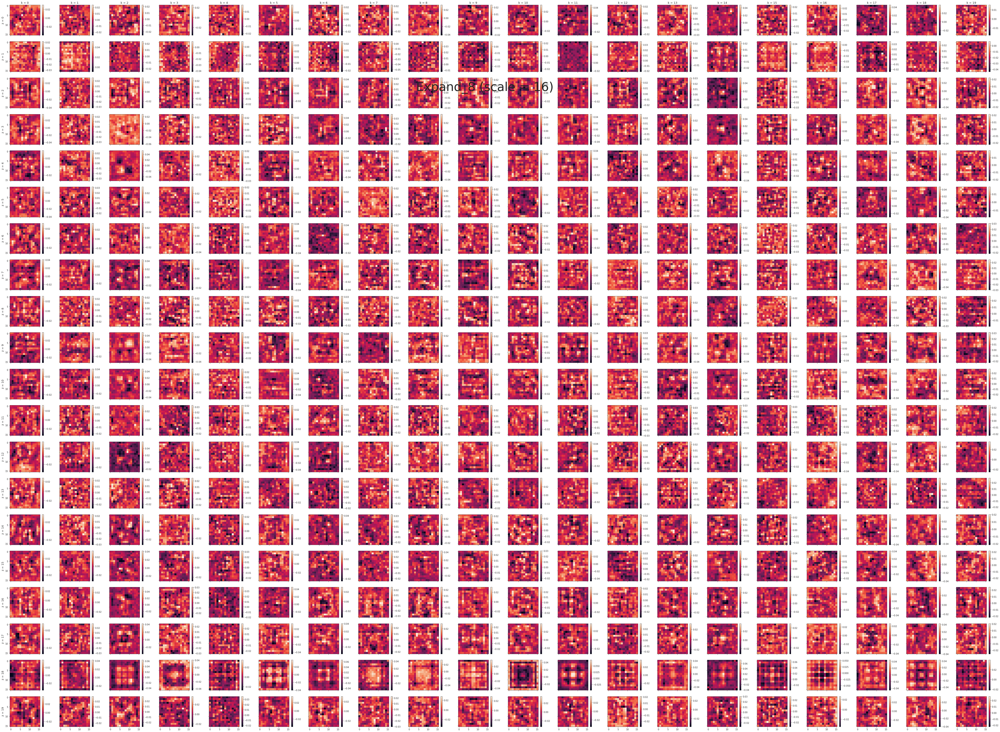

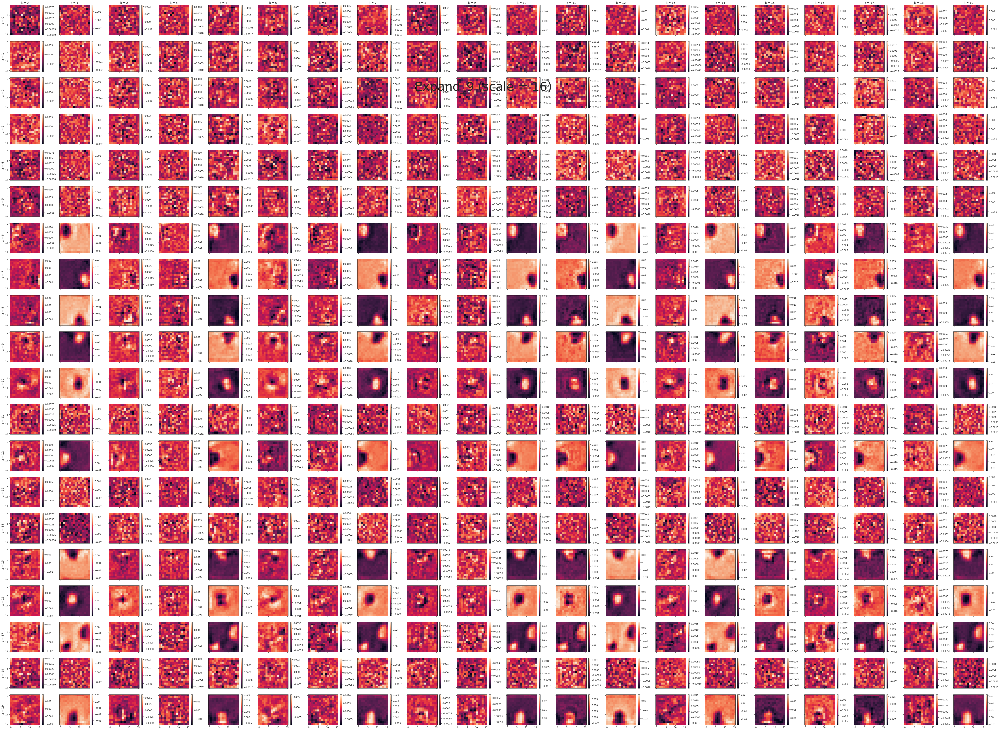

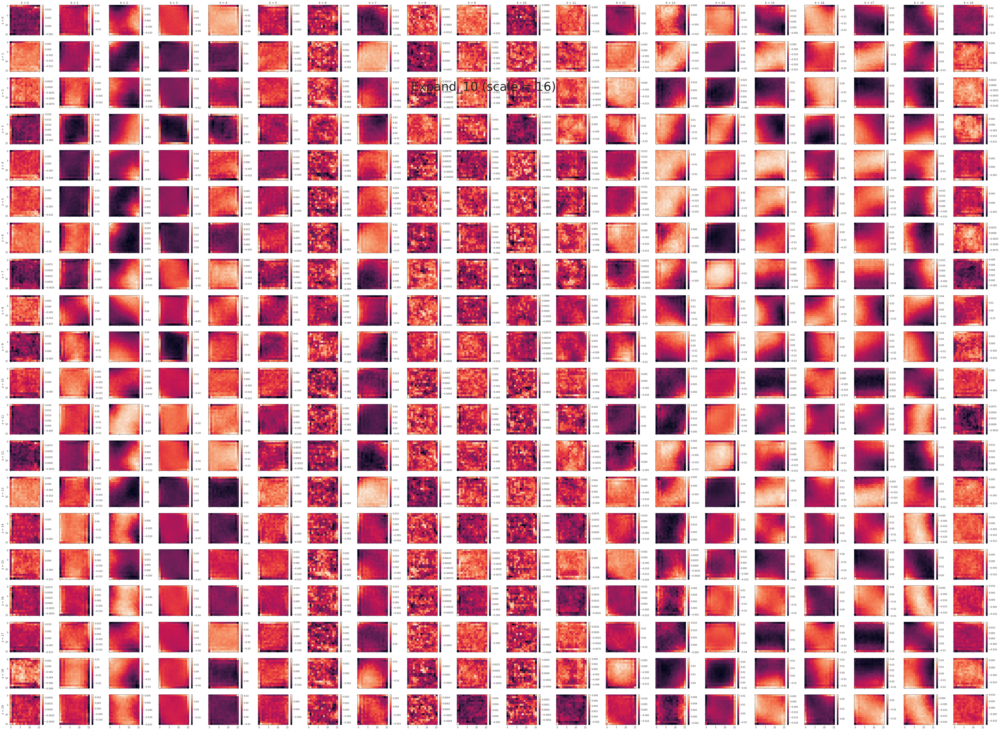

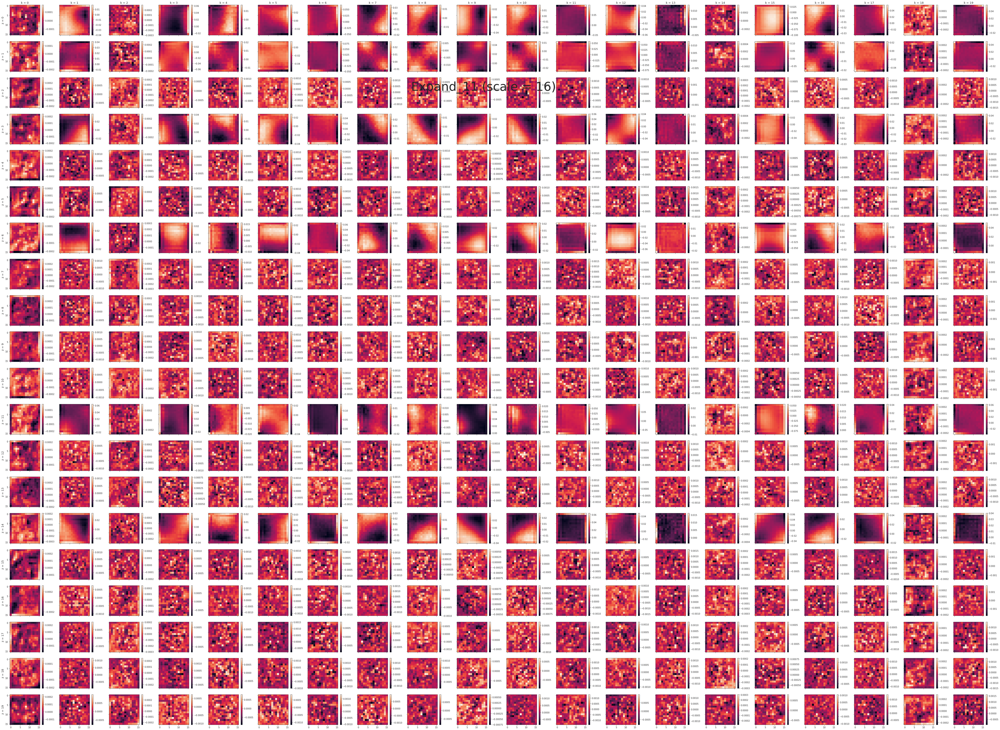

In [105]:
scales, _ = tr.model.latent_scales()
num = vae.cfg.n_latent_per_group

for i, _w in w2p.items():
    fig, axes = create_figure(num, num, (80, 60), 'all', 'all')
    for z, k in itertools.product(range(num), range(num)):
        ax = axes[z, k]
        im = ax.imshow(_w[z, k])
        plt.colorbar(im, ax=ax)
        if z == 0:
            ax.set_title(f"k = {k}", fontsize=13)
        if k == 0:
            ax.set_ylabel(f"z = {z}", fontsize=13)
    fig.suptitle(f'Expand_{i} (scale = {scales[i]})', fontsize=55, y=0.8)
    plt.show()